# Changelog

- train-test splitet előrehoztam az EDA elé (mert úgy logikus, ha bármilyen függvényformát csak a train alapján lövünk be, nem nézünk a tesztre). szerencsére ez az értelmezéseken semmit nem változtatott
- és mindig amikor bármi új változót hozunk létre, akkor azt rögtön a test-re is létrehozom
- beraktam a lin-quad spline függvényt az lspline definíciója után, és átírtam úgy hogy a mi helyzetünkre legyen jó (lineáris a knotig, utána kvadratikus)
- általánosságban egységesítettem az ábrák kinézetét
- beraktam az EDA részbe inkább még több hisztogramot, meg utána minden releváns lowesst kiplotoltam
- írtam egy függvényt ami segít kiplotolni az ilyen lpm meg logit meg ilyesmi modelleket anélkül hogy minden modelleredményt ki kelljen menteni
- a csak (ln_)romani_ratio-t használó regressziók formuláját rendbe raktam (interakciókra főleg). itt arra jöttem rá, hogy amúgy az ln_romani_ratio:flag az teljesen kollineáris a magával a flaggel. szóval igazából csak értelmezés szempontjából lenne jó szerintem, ha az interakciót tartjuk meg, nem a dummyt (mert az egyiket ugye ki kell dobni) mondjuk ez komplexebb modelleknél már nem feltétlenül igaz ott akár bentmaradhat mindkettő is, bár sok extra infót nem fog adni
- csináltam egy ciklust ami automatikosan kiírja kategóriák szerint hogy a korrelációs mátrixből mi milyen szinten korrelál
- PCA részt átírtam átláthatóbbra, meg kiszámoltam vele a pca-kat a tesztre is
- PCA-kban áttettem amit lehet level-ről logra (ld. hisztogramok miatt)
- csináltam egy új PCA kategóriát pop, area és pop_density változók logjával
- kiplotoltam a másodikkörös PCA-kat a közmunkásokkal szemben

# To do

- mindenhol rendbe tenni az interakciókat flag változóknál (romani, educ)
- esetleg pca-kra függvényformákat nézni?
- markdown leírást adni és kicsit formázni
- többváltozós modelleknél átállni logitra mindenhol
- esetleg status és county dummykat rakni a többváltozós modellekbe
- ahol lehet, áttérni log értékekre
- vmi nagy modellösszehasonlítás és konkludálás, hogy akkor melyik modell is tetszik nekünk a valószínűségi modellek közül
- ehhez lehetne nézni olyan diagnosztikákat, amiket órán vettünk (akár model fitre, akár kalibrációra, akár biasra)

# Coding 1 & Data Analysis 2 - Home Assignment 2
### Authors: Gréta Zsikla & Márton Nagy

Importing the needed packages.

In [597]:
import pandas as pd
import math
import numpy as np
from plotnine import *
import patchworklib as pw
import statsmodels.api as sm
import statsmodels.formula.api as smf
from stargazer.stargazer import Stargazer
import warnings
%matplotlib inline
warnings.filterwarnings("ignore")
from datetime import timedelta
import scipy.stats as stats
from IPython.display import display
from mizani.formatters import percent_format
import copy
import statsmodels.nonparametric.kernel_regression as loess
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import log_loss
#from patsy import dmatrices

## Importing the raw data files

Reading the raw Excel-sheet, as downloaded from TEIR.

In [393]:
raw = pd.read_excel('https://github.com/marton-nagy-marton/DA2_assignment2/raw/refs/heads/main/source_data_teir_ksh.xlsx', sheet_name='raw')

Renaming the indicators to be computer friendly and transposing the DataFrame.

In [395]:
indicators_renamed = [
    "muni_name",
    "comm_work",
    "romani_pctg",
    "dependence_rate",
    "pop",
    "pop_15_64f",
    "pop_15_64m",
    "county_center_min",
    "hprest_emp_pctg",
    "unemp_pctg",
    "area",
    "roads_undev",
    "roads_dev",
    "roads_total",
    "income",
    "gp_visits",
    "elem_students",
    "disadv_elem_students",
    "crime_per1000people",
    "low_comf_housing",
    "educ_level_max_elem",
    "migration_per1000",
    "growth_decline_per1000",
    "elem_stud_from_other_muni_pctg",
    "pop_65-x_m",
    "pop_65-x_f",
    "people_in_agriculture",
    "employed",
    "pop_7_x"
]
tidy = raw.iloc[:,1:].T
tidy.reset_index(drop = False, inplace = True)
tidy.columns = indicators_renamed
tidy

,muni_name,comm_work,romani_pctg,dependence_rate,pop,pop_15_64f,pop_15_64m,county_center_min,hprest_emp_pctg,unemp_pctg,...,low_comf_housing,educ_level_max_elem,migration_per1000,growth_decline_per1000,elem_stud_from_other_muni_pctg,pop_65-x_m,pop_65-x_f,people_in_agriculture,employed,pop_7_x
0,Aba (1737),10.0,0.41,47.89,4633.0,1662.0,1797.0,20.48,12.25,51.81,...,5.89,1188.0,-3.82,-3.14,12.87,255.0,439.0,22.0,2366.0,4051.0
1,Abádszalók (1244),136.0,4.24,56.27,4180.0,1402.0,1570.0,61.78,15.33,44.59,...,10.96,982.0,5.17,-13.97,17.77,366.0,514.0,10.0,1688.0,3608.0
2,Abaliget (1254),13.0,8.57,57.18,659.0,234.0,251.0,22.75,26.47,37.50,...,6.34,99.0,-24.04,-1.60,47.19,44.0,59.0,1.0,323.0,572.0
3,Abasár * (2455),4.0,0.51,59.62,2540.0,817.0,938.0,44.45,19.81,49.43,...,5.27,442.0,28.49,-18.99,29.21,229.0,350.0,4.0,1270.0,2359.0
4,Abaújalpár (1566),5.0,NaN,39.13,67.0,28.0,26.0,46.28,20.00,100.00,...,NaN,21.0,0.00,0.00,NaN,3.0,8.0,0.0,30.0,60.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3150,Zsennye (1229),NaN,NaN,80.36,106.0,31.0,33.0,29.62,21.05,60.00,...,NaN,17.0,0.00,0.00,NaN,15.0,17.0,0.0,39.0,82.0
3151,Zsira (462),NaN,0.35,48.82,850.0,302.0,300.0,78.09,21.60,NaN,...,4.98,187.0,23.34,-25.80,50.78,72.0,96.0,0.0,412.0,819.0
3152,Zsombó (1776),4.0,0.15,50.25,3574.0,1259.0,1380.0,20.08,26.74,40.00,...,8.22,626.0,12.91,0.90,13.43,283.0,338.0,6.0,1778.0,3124.0
3153,Zsujta (1102),11.0,16.74,102.75,239.0,63.0,67.0,51.14,11.84,73.33,...,16.48,79.0,307.29,-46.88,NaN,22.0,64.0,1.0,79.0,204.0


Extracting the municipality ID and municipality name from the raw data.

In [397]:
tidy['muni_id'] = tidy['muni_name'].apply(lambda x: int(x.split('(')[-1].split(')')[0]))
tidy['muni_name'] = tidy['muni_name'].apply(lambda x: x.replace(' *', '').split(' (')[0])

We connect the data using the municipality names to an administrative dataset on the status, counties and districts of each municipality. This is the 'Helységnévtár' sheet downloaded from KSH.

In [399]:
status = pd.read_excel('https://github.com/marton-nagy-marton/DA2_assignment2/raw/refs/heads/main/source_data_teir_ksh.xlsx', sheet_name='hnt', skiprows = 2)
merged = tidy.merge(status, how = 'inner', left_on='muni_name', right_on='Helység megnevezése')
tidy['status'] = merged['Helység jogállása'].str.strip()
tidy['county'] = merged['Vármegye megnevezése'].str.strip()
tidy['district'] = merged['Járás neve'].str.strip()

## Data cleaning and dealing with missing values

Applying some cleaning to the status column: we create a dummy for the municipality being a county center.

In [401]:
tidy['status'].unique()

array(['város', 'község', 'nagyközség', 'megyei jogú város',
       'megyeszékhely, megyei jogú város', 'főváros'], dtype=object)

In [402]:
tidy['is_county_center'] = tidy['status'].apply(lambda x: 1 if x in ['megyeszékhely, megyei jogú város', 'főváros'] else 0)

In [403]:
tidy['status'] = tidy['status'].apply(lambda x: 'megyei jogú város' if x == 'megyeszékhely, megyei jogú város' else x)

Reordering the columns.

In [405]:
tidy = tidy.filter(['muni_id','muni_name','status','is_county_center','county','district','comm_work','romani_pctg','dependence_rate','pop','pop_15_64f','pop_15_64m',
              'county_center_min','hprest_emp_pctg','unemp_pctg','area','roads_undev','roads_dev','roads_total','income','gp_visits',
              'elem_students','disadv_elem_students','crime_per1000people','low_comf_housing','educ_level_max_elem',
              'migration_per1000','growth_decline_per1000','elem_stud_from_other_muni_pctg','pop_65-x_m','pop_65-x_f','people_in_agriculture',
              'employed', 'pop_7_x'])

Now let's inspect the DataFrame to see the number of missing values by variable.

In [408]:
tidy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3155 entries, 0 to 3154
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   muni_id                         3155 non-null   int64  
 1   muni_name                       3155 non-null   object 
 2   status                          3155 non-null   object 
 3   is_county_center                3155 non-null   int64  
 4   county                          3154 non-null   object 
 5   district                        3154 non-null   object 
 6   comm_work                       2914 non-null   float64
 7   romani_pctg                     2352 non-null   float64
 8   dependence_rate                 3155 non-null   float64
 9   pop                             3155 non-null   float64
 10  pop_15_64f                      3155 non-null   float64
 11  pop_15_64m                      3155 non-null   float64
 12  county_center_min               31

Now let's deal with missing values for each variable.

In [410]:
tidy[tidy['county'].isna()]

,muni_id,muni_name,status,is_county_center,county,district,comm_work,romani_pctg,dependence_rate,pop,...,low_comf_housing,educ_level_max_elem,migration_per1000,growth_decline_per1000,elem_stud_from_other_muni_pctg,pop_65-x_m,pop_65-x_f,people_in_agriculture,employed,pop_7_x
393,1357,Budapest,főváros,1,NaN,NaN,510.0,0.77,51.02,1630320.0,...,1.2,202503.0,-3.02,-4.69,9.16,136116.0,226702.0,1192.0,913266.0,1590653.0


It turns out that the capital does not have statistically a district and a county. For our purposes, let's change this by assigning Budapest as a county and a district.

In [412]:
tidy['county'] = tidy['county'].fillna('Budapest')
tidy['district'] = tidy['district'].fillna('Budapest')

For the quantitative variables, let's look at the descriptive statistics first.

In [414]:
desc_na = tidy.iloc[:,6:].describe().T
desc_na[desc_na['count'] != 3155]

,count,mean,std,min,25%,50%,75%,max
comm_work,2914.0,26.140014,48.085477,1.00,4.0000,10.000,26.7500,734.00
romani_pctg,2352.0,5.968274,9.497803,0.09,0.8000,2.440,6.9725,90.16
county_center_min,3136.0,44.438712,20.391054,6.80,29.3875,42.030,56.3025,144.94
hprest_emp_pctg,3152.0,15.747018,8.595697,0.43,10.0800,13.760,19.4800,73.91
unemp_pctg,3023.0,54.358951,16.616119,7.69,43.8000,54.050,63.6650,100.00
roads_undev,2889.0,5.372918,12.960453,0.01,1.0500,2.230,5.3100,304.58
roads_dev,3109.0,13.611039,88.040840,0.01,2.2000,4.890,11.3400,4643.50
roads_total,3141.0,18.414225,95.542847,0.05,3.6500,7.660,16.4200,4948.08
elem_students,1742.0,410.536739,2950.346566,5.00,88.0000,146.000,250.7500,117627.00
disadv_elem_students,1430.0,26.660839,45.338232,1.00,5.0000,14.000,33.0000,1034.00


As we can see, most of the variables have a larger than 0 minimum, which is suspicious. The reason for this is most apparent in the case of county_center_min: missing values should actually be zero!

In [416]:
tidy[tidy['county_center_min'].isna()][['muni_name', 'is_county_center']]

,muni_name,is_county_center
251,Békéscsaba,1
393,Budapest,1
556,Debrecen,1
660,Eger,1
919,Győr,1
1199,Kaposvár,1
1241,Kecskemét,1
1738,Miskolc,1
1966,Nyíregyháza,1
2127,Pécs,1


As we can see, the only missing values are for those municipalities that are county centers themselves.

We decided to impute missing values with zero for the every variable except: roads_total, roads_undev, roads_dev, students_from_other_village_pctg, and pop_7_x. We will get back to these variables later.

In [420]:
tidy[['comm_work', 'romani_pctg', 'dependence_rate', 'pop', 'pop_15_64f', 'pop_15_64m',
      'county_center_min', 'hprest_emp_pctg', 'unemp_pctg', 'area', 'income', 'gp_visits',
      'elem_students', 'disadv_elem_students', 'crime_per1000people', 
      'low_comf_housing', 'educ_level_max_elem', 'migration_per1000', 'growth_decline_per1000', 
      'pop_65-x_m', 'pop_65-x_f', 'people_in_agriculture', 'employed']] = \
tidy[['comm_work', 'romani_pctg', 'dependence_rate', 'pop', 'pop_15_64f', 'pop_15_64m',
      'county_center_min', 'hprest_emp_pctg', 'unemp_pctg', 'area', 'income', 'gp_visits',
      'elem_students', 'disadv_elem_students', 'crime_per1000people', 
      'low_comf_housing', 'educ_level_max_elem', 'migration_per1000', 'growth_decline_per1000', 
      'pop_65-x_m', 'pop_65-x_f', 'people_in_agriculture', 'employed']].fillna(0)


For the roads variables, it is not quite obvious what the missing values represent, even though the minima are never zero. E.g. for some municipalities the total is given but there is no breakdown whether the roads are developed or undeveloped. Also, these variables give information only about roads managed by the municipality government. So, we have decided not to include these variables in our analysis as it was ambigous how we should treat missing values (and there were a lot of missing values).

For the population above 7 years of age, it is unplausible that there is a municipality where there are no people above 7. However, as only one observation is missing, we can simply exclude that.

For the percentage of students from other municipalities, the minimum is already zero. This indicates that there are students in that municipality, but there are no students from other municipalities. So, this variable should only be missing if there are no students in that municipality, as then we would have to divide by zero. We can check if this is the case.

In [423]:
tidy.shape

(3155, 34)

In [424]:
tidy.drop(columns = ['roads_undev','roads_dev','roads_total'], inplace = True)
tidy = tidy[tidy['pop_7_x'].notna()]

In [425]:
tidy.shape

(3154, 31)

Below, we can see that indeed, the percentage of students from other municipalities is only missing if the number of elementary students is zero. So these missing values make sense - thus we shall leave them as is for now.

In [427]:
tidy[(tidy['elem_students'] != 0) & tidy['elem_stud_from_other_muni_pctg'].isna()][['muni_name', 'elem_students', 'elem_stud_from_other_muni_pctg']]

,muni_name,elem_students,elem_stud_from_other_muni_pctg


Now we can create some new variables. What we do is basically two things:
- convert percentages to ratio variables,
- and calculate ratio variables (e.g. per capita, per employed people) by dividing with a sensible reference group.

In [429]:
tidy['pop_15_64'] = tidy['pop_15_64m'] + tidy['pop_15_64f']
tidy['pop_65_x'] = tidy['pop_65-x_m'] + tidy['pop_65-x_f']
tidy['pop_density'] = tidy['pop'] / tidy['area']
tidy['old_age_dependency_ratio'] = tidy['pop_65_x'] / tidy['pop_15_64']
tidy['gen_dependency_ratio'] = tidy['dependence_rate'] / 100
tidy['comm_work_per_employed'] = tidy['comm_work'] / tidy['employed']
tidy['monthly_income_pc'] = tidy['income'] / tidy['pop'] / 12
tidy['max_elem_educ_ratio'] = tidy['educ_level_max_elem'] / tidy['pop_7_x']
tidy['agr_emp_ratio'] = tidy['people_in_agriculture'] / tidy['employed']
tidy['disadv_elem_students_ratio'] =  tidy['disadv_elem_students'] / tidy['elem_students']
tidy['avg_gp_visits_pc'] = tidy['gp_visits'] / tidy['pop']
tidy['romani_ratio'] = tidy['romani_pctg'] / 100
tidy['hprest_emp_ratio'] = tidy['hprest_emp_pctg'] / 100
tidy['unemp_ratio'] = tidy['unemp_pctg'] / 100
tidy['elem_stud_from_other_muni_ratio'] = tidy['elem_stud_from_other_muni_pctg'] / 100
tidy['low_comf_housing_ratio'] = tidy['low_comf_housing'] / 100

In [430]:
tidy = tidy.filter([
    'muni_id',
    'muni_name',
    'status',
    'is_county_center',
    'county',
    'district',
    'comm_work_per_employed',
    'romani_ratio',
    'monthly_income_pc',
    'unemp_ratio',
    'hprest_emp_ratio',
    'agr_emp_ratio',
    'pop_density',
    'old_age_dependency_ratio',
    'gen_dependency_ratio',
    'migration_per1000',
    'growth_decline_per1000',
    'max_elem_educ_ratio',
    'disadv_elem_students_ratio',
    'elem_stud_from_other_muni_ratio',
    'county_center_min',
    'low_comf_housing_ratio',
    'crime_per1000people',
    'avg_gp_visits_pc',
    'pop',
    'area'
])

In [431]:
tidy.iloc[:,5:].describe().T

,count,mean,std,min,25%,50%,75%,max
comm_work_per_employed,3154.0,0.060158,0.090473,0.000000,0.006509,0.025499,0.077306,9.723757e-01
romani_ratio,3154.0,0.044507,0.086034,0.000000,0.000000,0.011650,0.046900,9.016000e-01
monthly_income_pc,3154.0,144094.057371,44823.142441,20377.844887,112652.492078,141648.685080,172594.374752,4.901384e+05
unemp_ratio,3154.0,0.521012,0.195523,0.000000,0.421100,0.529400,0.633300,1.000000e+00
hprest_emp_ratio,3154.0,0.157226,0.085904,0.000000,0.100725,0.137600,0.194375,7.391000e-01
agr_emp_ratio,3154.0,0.011689,0.017606,0.000000,0.001330,0.005797,0.014794,1.764706e-01
pop_density,3154.0,73.549782,133.183612,1.515152,25.833222,42.381289,72.074074,3.104603e+03
old_age_dependency_ratio,3154.0,0.273532,0.089486,0.034063,0.220081,0.261092,0.313575,1.085106e+00
gen_dependency_ratio,3154.0,0.547398,0.093281,0.115400,0.494600,0.539850,0.590675,1.750000e+00
migration_per1000,3154.0,0.305371,33.919665,-514.290000,-13.352500,0.285000,15.087500,3.072900e+02


There is one thing left to do for dealing with missing values. We shall set the student ratio variables to 0 if they are missing (remember, this indicated that there are no elementary students in that municipality), but we should also create a dummy flag to capture this.

In [437]:
tidy['no_elem_stud'] = tidy['disadv_elem_students_ratio'].apply(lambda x: 1 if pd.isna(x) else 0)

In [441]:
tidy[['disadv_elem_students_ratio', 'elem_stud_from_other_muni_ratio']] = tidy[['disadv_elem_students_ratio', 'elem_stud_from_other_muni_ratio']].fillna(0)

We have decided to exclude Budapest, the capital of Hungary of the analysis, as we do not have district-level data on it, without which analysing it is kind of meaningless.

In [445]:
tidy = tidy[tidy['muni_name'] != 'Budapest']

Lastly, we split our sample to a train (80%) and test (20%) set to carry out some robustness analysis in the end. We will do every further analysis step based on the train sample only. However, if we happen to create some new variables (e.g. polynomials or log transformation) along the way, we will recreate them in the test sample as well

In [455]:
train, test = train_test_split(
    tidy, test_size=0.2, random_state=42)

## Exploratory data analysis

In [458]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2522 entries, 1297 to 861
Data columns (total 27 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   muni_id                          2522 non-null   int64  
 1   muni_name                        2522 non-null   object 
 2   status                           2522 non-null   object 
 3   is_county_center                 2522 non-null   int64  
 4   county                           2522 non-null   object 
 5   district                         2522 non-null   object 
 6   comm_work_per_employed           2522 non-null   float64
 7   romani_ratio                     2522 non-null   float64
 8   monthly_income_pc                2522 non-null   float64
 9   unemp_ratio                      2522 non-null   float64
 10  hprest_emp_ratio                 2522 non-null   float64
 11  agr_emp_ratio                    2522 non-null   float64
 12  pop_density            

In [459]:
train.iloc[:,5:].describe(percentiles=[0.05,0.25, 0.5, 0.75, 0.95]).T.applymap(lambda x: format(x, '.4f'))

,count,mean,std,min,5%,25%,50%,75%,95%,max
comm_work_per_employed,2522.0000,0.0592,0.0877,0.0000,0.0000,0.0067,0.0253,0.0757,0.2292,0.9724
romani_ratio,2522.0000,0.0444,0.0842,0.0000,0.0000,0.0000,0.0119,0.0478,0.2066,0.9016
monthly_income_pc,2522.0000,143894.8780,44442.1543,23215.0949,76550.3041,112905.7347,141648.6851,171671.1950,219872.0137,490138.4280
unemp_ratio,2522.0000,0.5201,0.1946,0.0000,0.1583,0.4211,0.5292,0.6364,0.8000,1.0000
hprest_emp_ratio,2522.0000,0.1568,0.0851,0.0000,0.0552,0.1008,0.1374,0.1931,0.3200,0.7143
agr_emp_ratio,2522.0000,0.0116,0.0174,0.0000,0.0000,0.0013,0.0058,0.0149,0.0433,0.1765
pop_density,2522.0000,72.6993,125.3693,1.5152,11.4164,26.1348,42.9965,73.1087,211.1508,2094.4079
old_age_dependency_ratio,2522.0000,0.2735,0.0883,0.0367,0.1574,0.2206,0.2607,0.3138,0.4325,1.0851
gen_dependency_ratio,2522.0000,0.5472,0.0906,0.1154,0.4203,0.4948,0.5407,0.5907,0.6944,1.2500
migration_per1000,2522.0000,0.5458,34.5836,-514.2900,-47.9975,-12.8750,0.5650,15.2300,44.8590,307.2900


In [460]:
def plot_histogram(df, col, bw, xlabel):
    p = (
        ggplot(df)
        + aes(x = col)
        + geom_histogram(
            aes(y=after_stat("count / np.sum(count)")),
            fill = 'lightgrey', 
            color = 'black', 
            binwidth = bw
        )
        + scale_x_continuous(
            expand=(0.01, 0),
        )
        + scale_y_continuous(
            expand=(0, 0.001),
            labels=percent_format()
        )
        + labs(
            x = xlabel,
            y = 'Percentage'
        )
        + theme_light()
    )
    return p

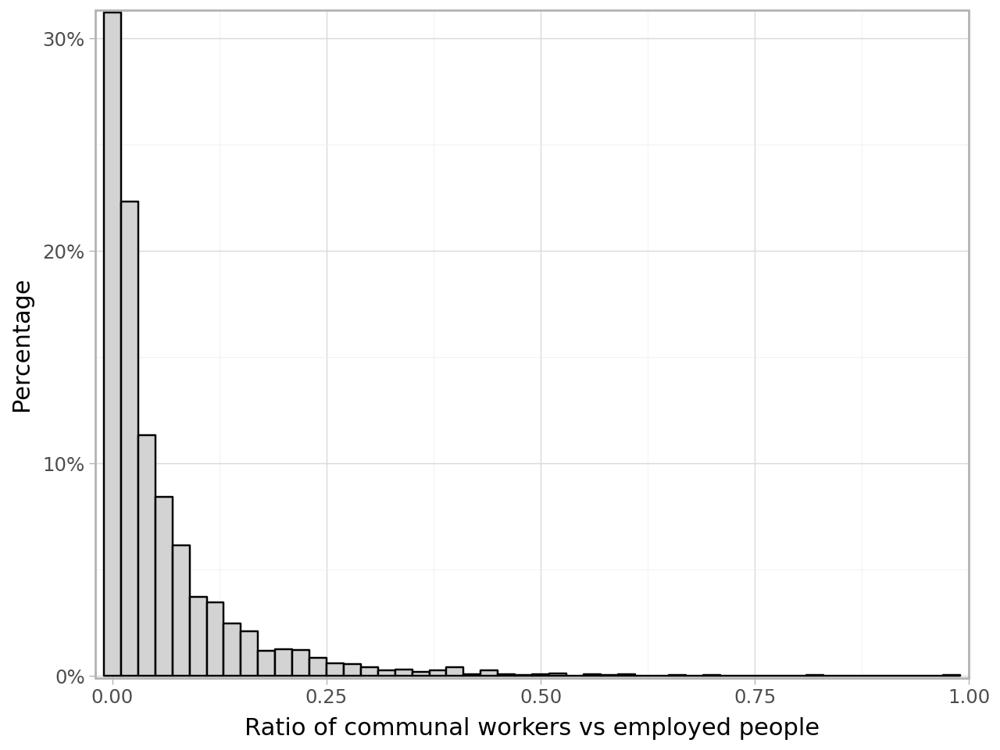

In [462]:
plot_histogram(train, 'comm_work_per_employed', 0.02, 'Ratio of communal workers vs employed people')

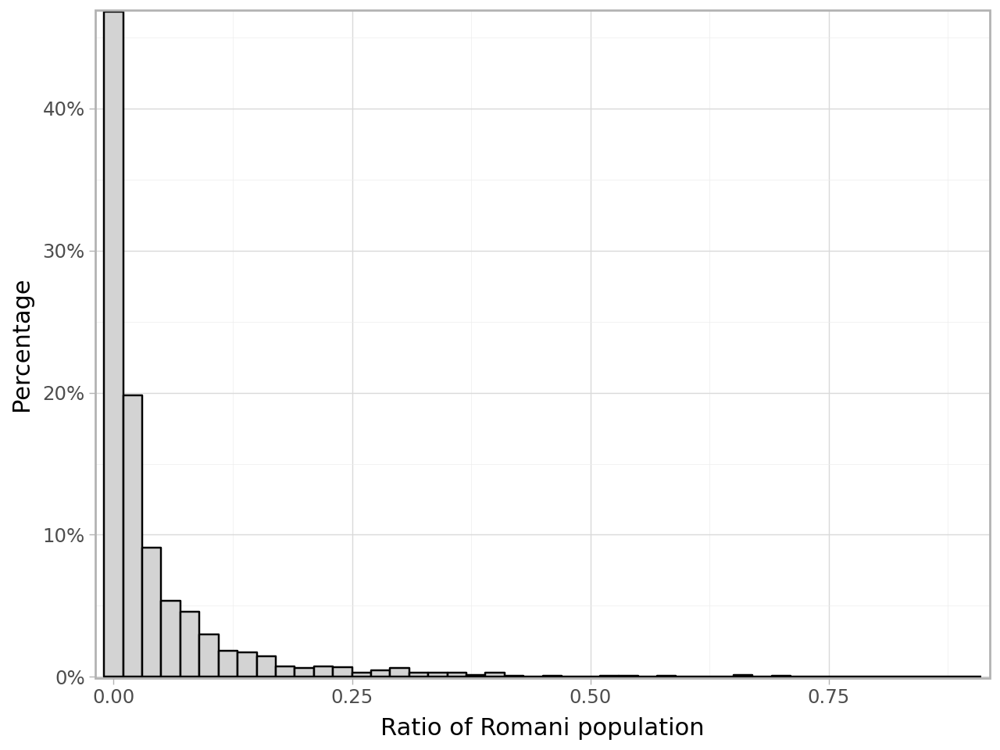

In [463]:
plot_histogram(train, 'romani_ratio', 0.02, 'Ratio of Romani population')

From the above histograms, it seems that both of our variables of interest have a very long right tail. However, there are also a significant amount of zero values as well. So, how should we handle this? We cannot simply drop all observations where either of the variables is zero, as we would end up with only 886 observations instead of 3153.

Our idea was the following:
- estimate two regression models: a probability model for the whole sample, where we predict the probability of the municipality having communal workers, and a regular OLS model for a subsample for municipalities where there are communal workers (here we can take the log as well);
- and we take the log of the Romani population by: (1) assigning a small, but positive value before taking the log, and (2) creating a flag to indicate whether the initial value was actually zero.

In [465]:
for sample in [train, test]:
    sample['ln_romani_ratio'] = sample['romani_ratio'].apply(
        lambda x: np.log(np.min(sample[sample['romani_ratio'] != 0].romani_ratio)*0.5)
        if x == 0
        else np.log(x))
    sample['romani_zero_flag'] = sample['romani_ratio'].apply(lambda x: 1 if x == 0 else 0)
    #note that this creates missing values, but that's fine, as we will only use this if it is not mising
    sample['ln_comm_work_per_employed'] =  sample['comm_work_per_employed'].apply(lambda x: np.log(x) if x != 0 else np.nan)
    sample['has_comm_worker'] = sample['comm_work_per_employed'].apply(lambda x: 1 if x != 0 else 0)

As we can see, the distribution of log(romani ratio) is better, but still not optimal - but this is the best we can do if we want our coefficients to remain interpretable.

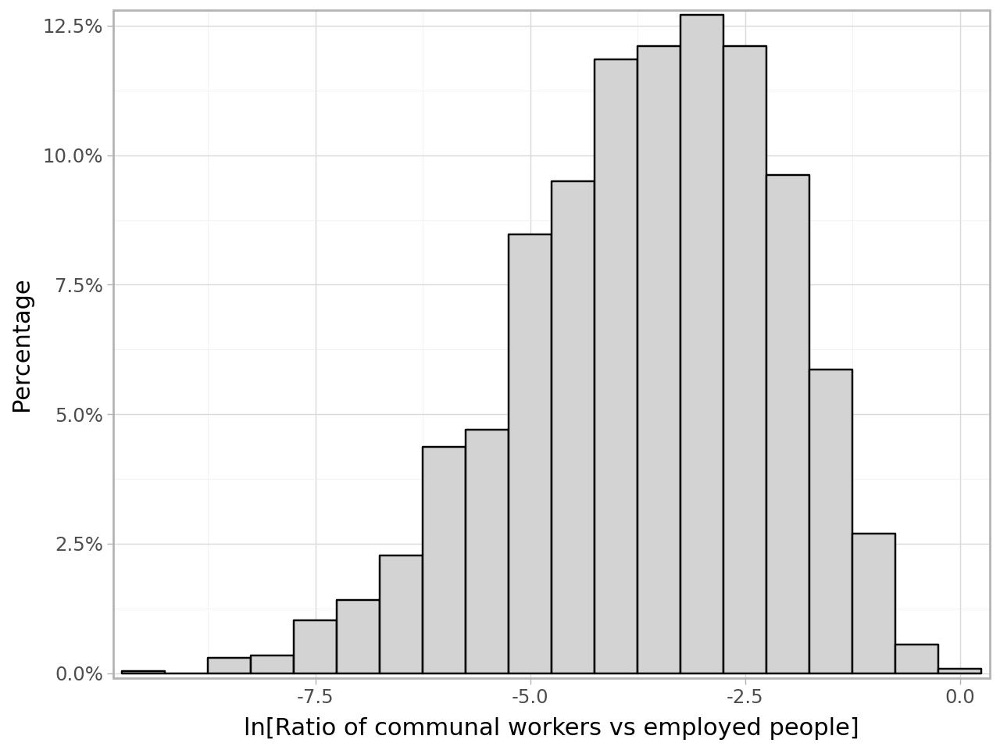

In [468]:
plot_histogram(train, 'ln_comm_work_per_employed', 0.5, 'ln[Ratio of communal workers vs employed people]')

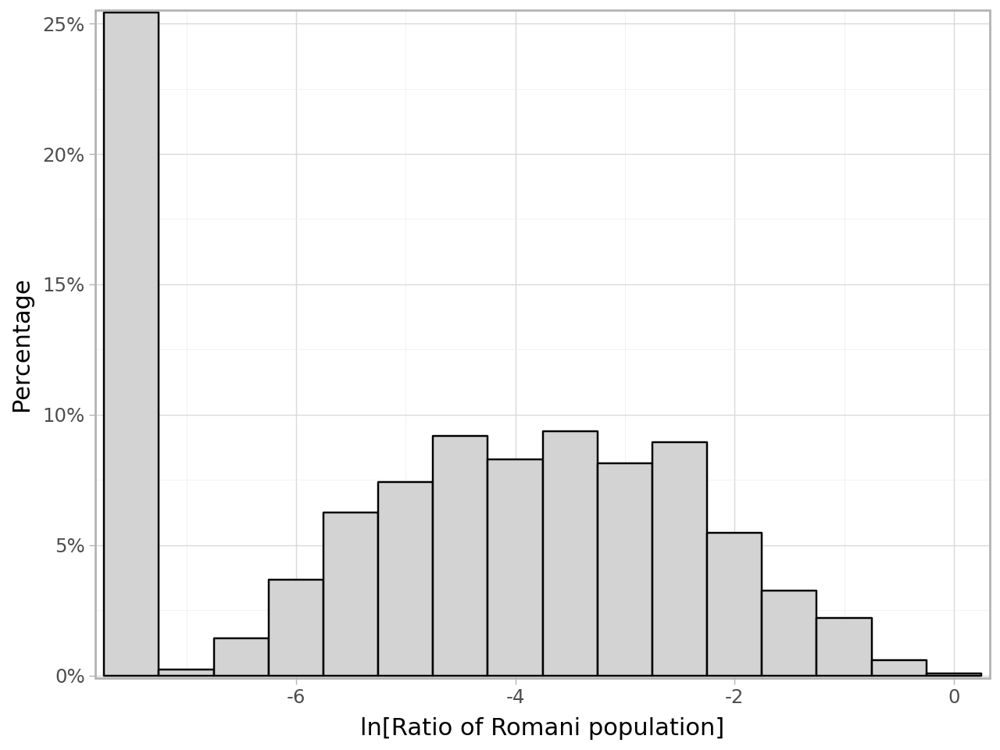

In [469]:
plot_histogram(train, 'ln_romani_ratio', 0.5, 'ln[Ratio of Romani population]')

Let's also take a look at the distribution of our other variables, which are strictly positive, as we might want to consider taking the log of them.

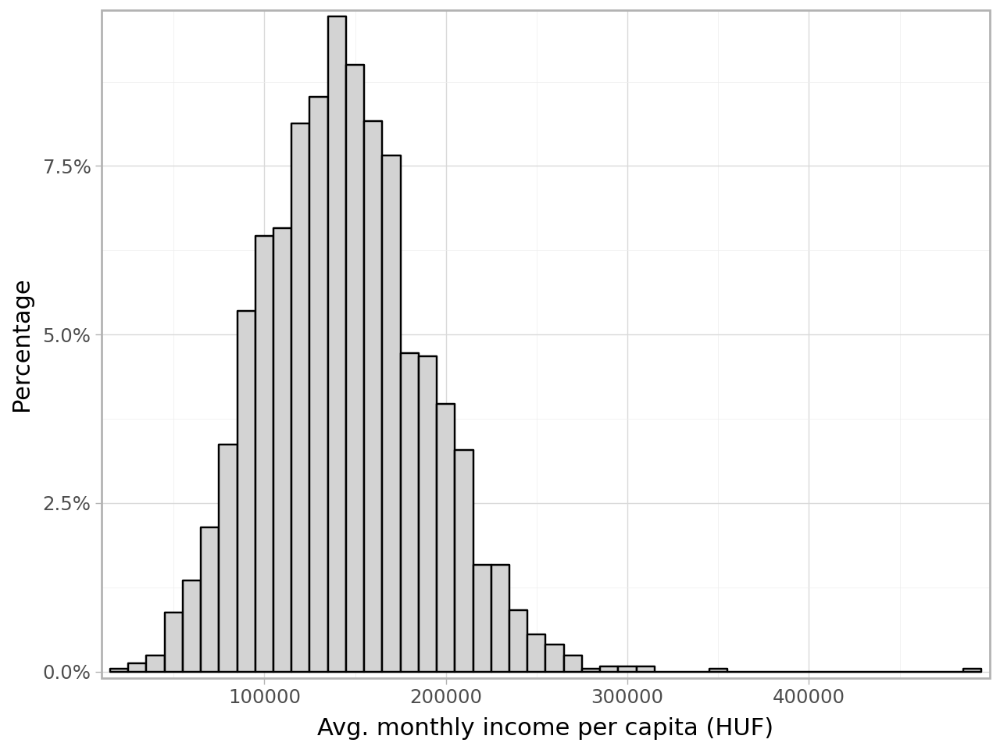

In [471]:
plot_histogram(train, 'monthly_income_pc', 10_000, 'Avg. monthly income per capita (HUF)')

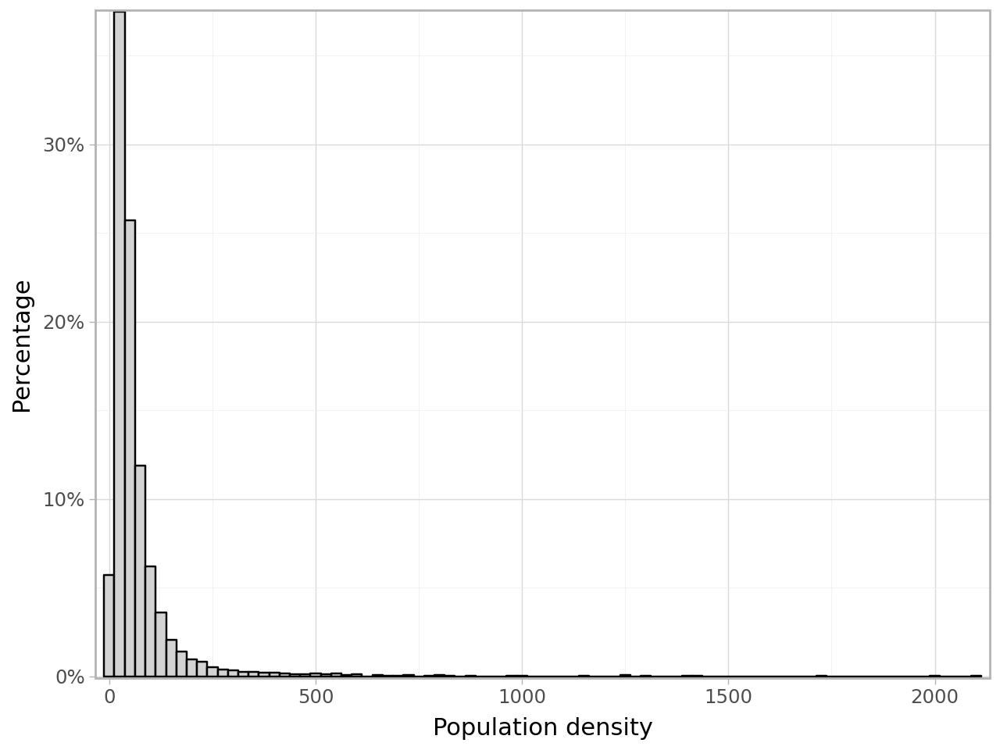

In [472]:
plot_histogram(train, 'pop_density', 25, 'Population density')

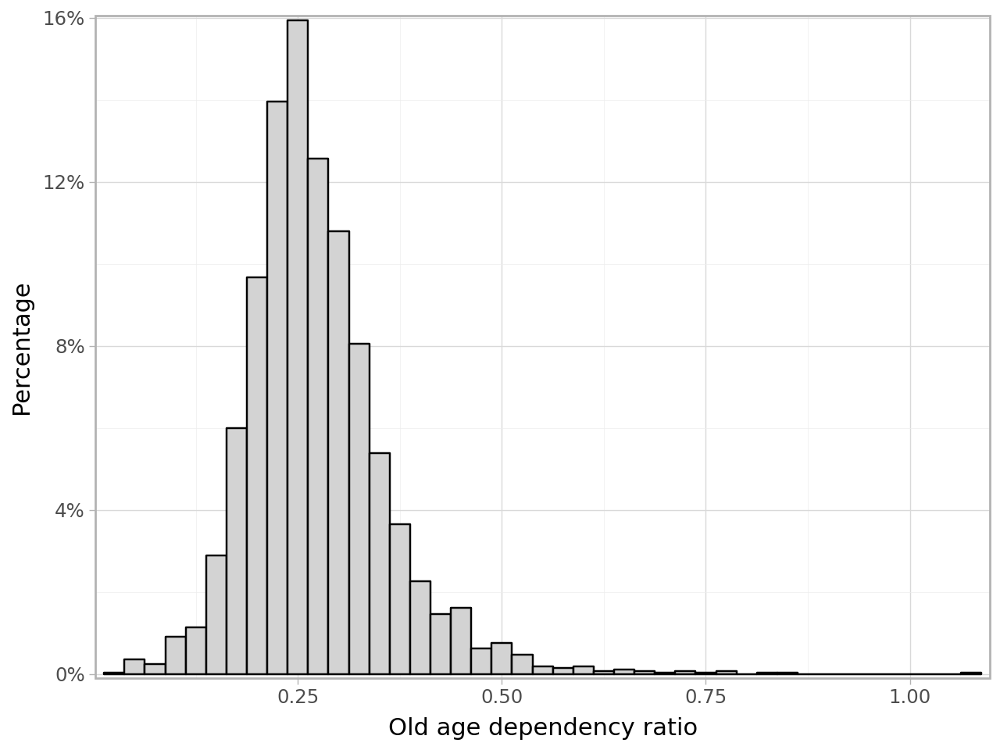

In [474]:
plot_histogram(train, 'old_age_dependency_ratio', 0.025, 'Old age dependency ratio')

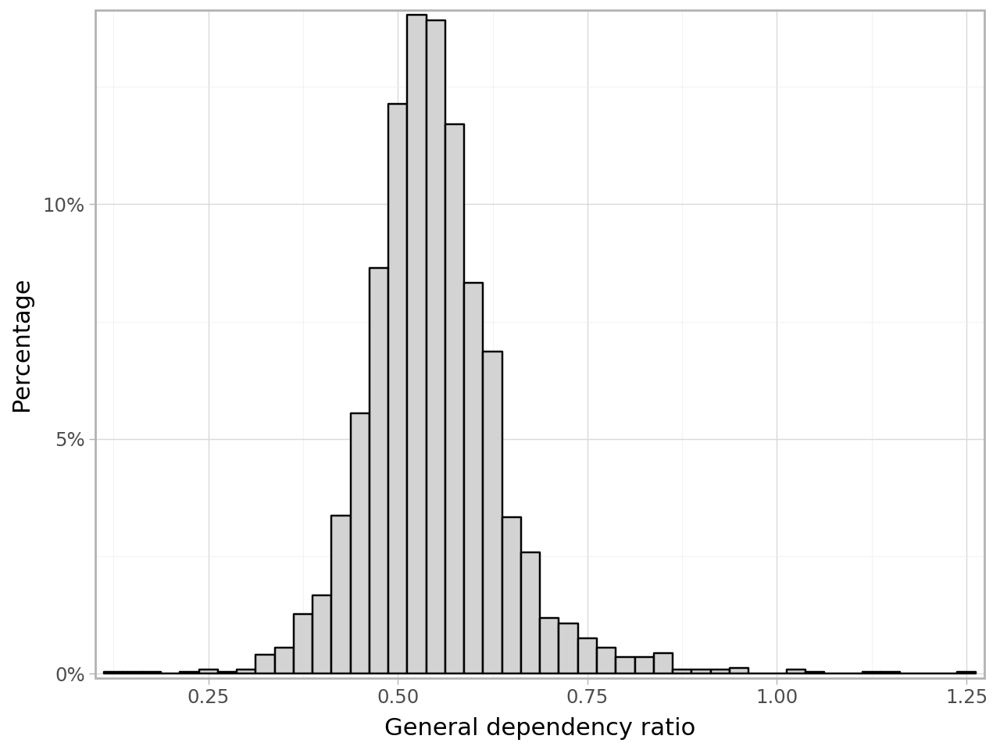

In [475]:
plot_histogram(train, 'gen_dependency_ratio', 0.025, 'General dependency ratio')

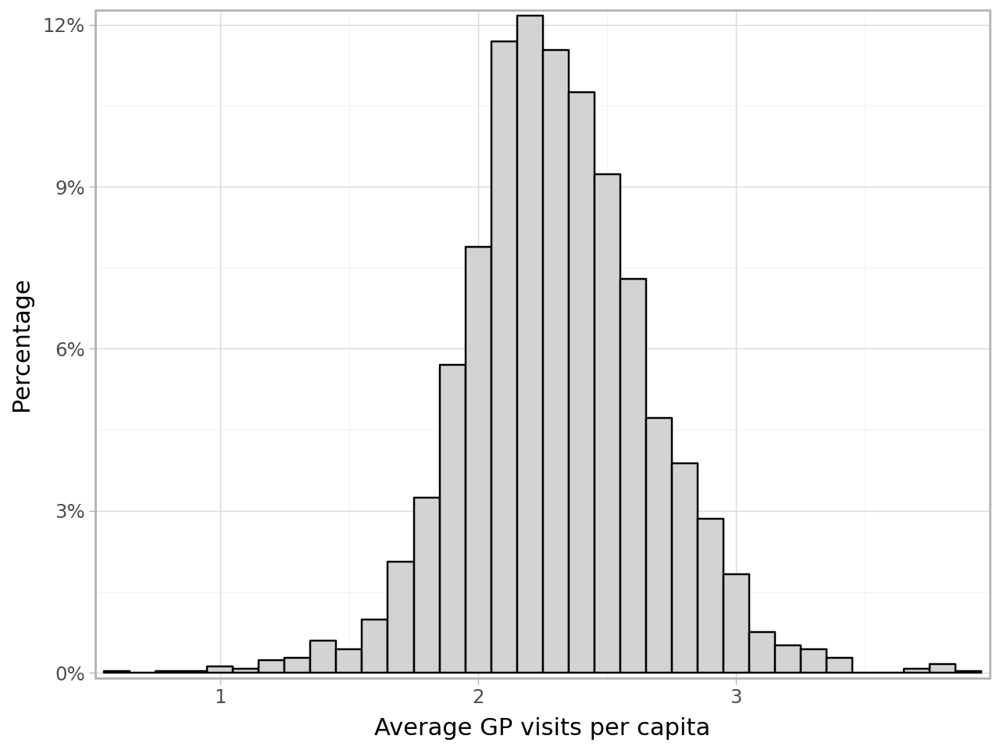

In [476]:
plot_histogram(train, 'avg_gp_visits_pc', 0.1, 'Average GP visits per capita')

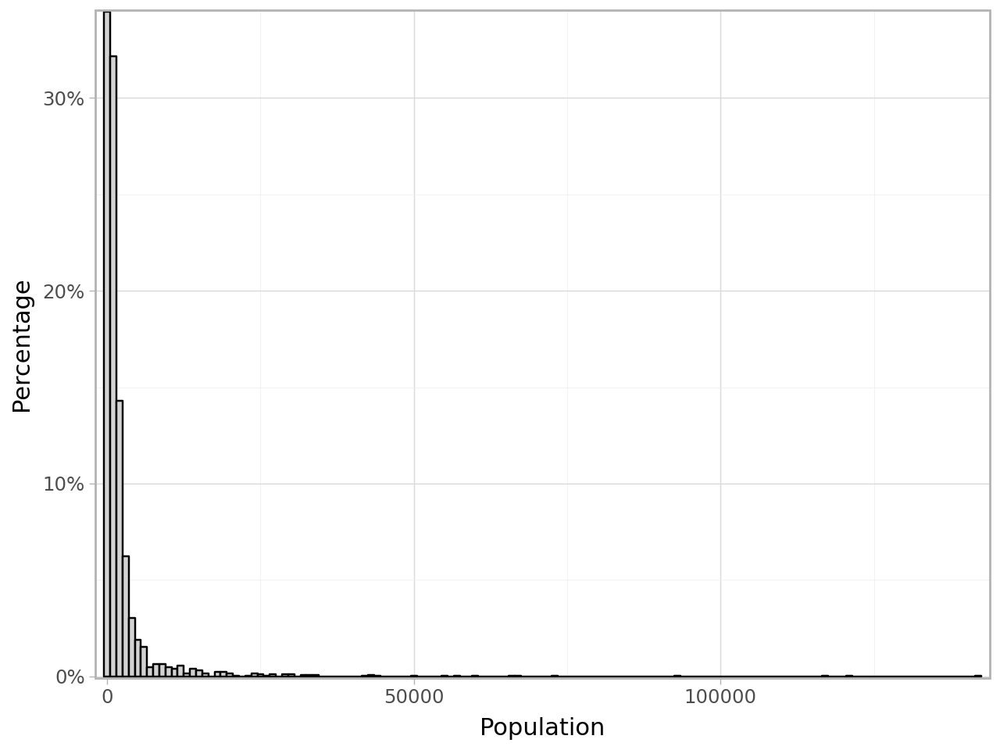

In [477]:
plot_histogram(train, 'pop', 1000, 'Population')

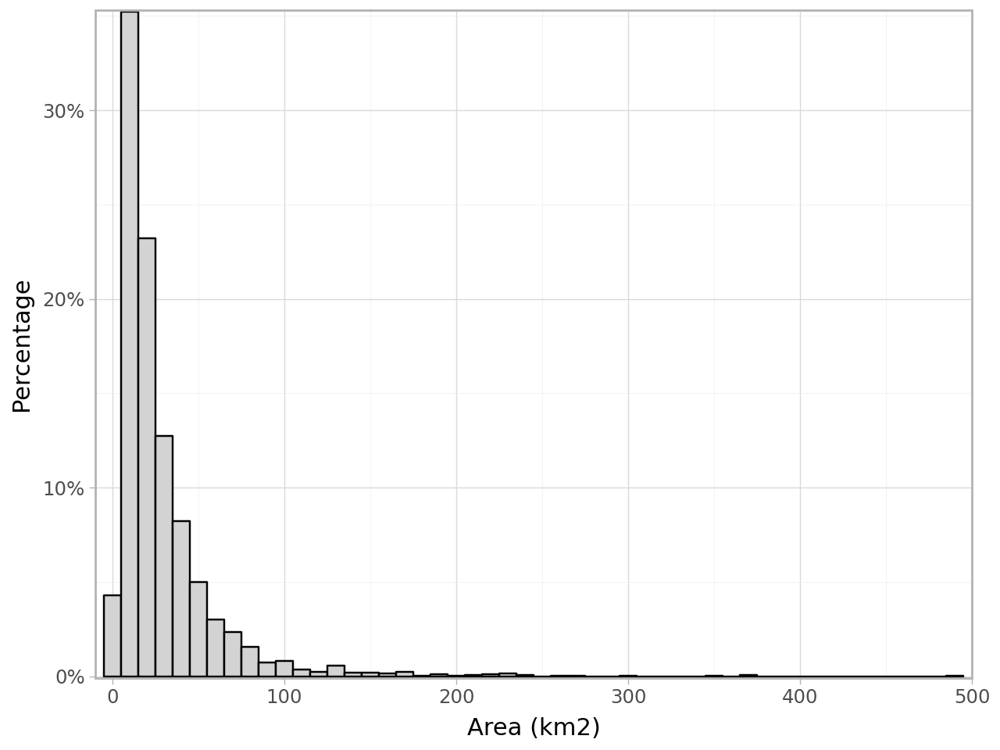

In [478]:
plot_histogram(train, 'area', 10, 'Area (km2)')

As we can see, even though some of them seem to follow quite a normal distribution, all of the variables have some extreme values. In order to account for this, we take logs.

In [480]:
for sample in [train, test]:
    sample['ln_monthly_income_pc'] = np.log(sample['monthly_income_pc'])
    sample['ln_pop_density'] = np.log(sample['pop_density'])
    sample['ln_old_age_dependency_ratio'] = np.log(sample['old_age_dependency_ratio'])
    sample['ln_gen_dependency_ratio'] = np.log(sample['gen_dependency_ratio'])
    sample['ln_avg_gp_visits_pc'] = np.log(sample['avg_gp_visits_pc'])
    sample['ln_pop'] = np.log(sample['pop'])
    sample['ln_area'] = np.log(sample['area'])

Finally, let's take a look at the summary statistics.

In [483]:
train.iloc[:,5:].describe(percentiles=[0.05,0.25, 0.5, 0.75, 0.95]).T.applymap(lambda x: format(x, '.4f'))

,count,mean,std,min,5%,25%,50%,75%,95%,max
comm_work_per_employed,2522.0000,0.0592,0.0877,0.0000,0.0000,0.0067,0.0253,0.0757,0.2292,0.9724
romani_ratio,2522.0000,0.0444,0.0842,0.0000,0.0000,0.0000,0.0119,0.0478,0.2066,0.9016
monthly_income_pc,2522.0000,143894.8780,44442.1543,23215.0949,76550.3041,112905.7347,141648.6851,171671.1950,219872.0137,490138.4280
unemp_ratio,2522.0000,0.5201,0.1946,0.0000,0.1583,0.4211,0.5292,0.6364,0.8000,1.0000
hprest_emp_ratio,2522.0000,0.1568,0.0851,0.0000,0.0552,0.1008,0.1374,0.1931,0.3200,0.7143
agr_emp_ratio,2522.0000,0.0116,0.0174,0.0000,0.0000,0.0013,0.0058,0.0149,0.0433,0.1765
pop_density,2522.0000,72.6993,125.3693,1.5152,11.4164,26.1348,42.9965,73.1087,211.1508,2094.4079
old_age_dependency_ratio,2522.0000,0.2735,0.0883,0.0367,0.1574,0.2206,0.2607,0.3138,0.4325,1.0851
gen_dependency_ratio,2522.0000,0.5472,0.0906,0.1154,0.4203,0.4948,0.5407,0.5907,0.6944,1.2500
migration_per1000,2522.0000,0.5458,34.5836,-514.2900,-47.9975,-12.8750,0.5650,15.2300,44.8590,307.2900


## Non-parametric regression analysis

In [488]:
def plot_lowess(df, x, y, xtitle = None, ytitle = None, title = None, span = 0.75):
    p = (
        ggplot(df)
        + aes(x = x, y = y)
        + geom_point(color = 'grey', alpha = 0.1)
        + geom_smooth(method = 'loess', se = False, span = span)
        + theme_light()
        + scale_x_continuous(expand=(0.01, 0.01))
        + scale_y_continuous(expand=(0.01, 0.01))
        + labs(x = xtitle if xtitle is not None else x,
               y = ytitle if ytitle is not None else y,
               title = title,
              )
    )
    return p

For the binary-outcome set up, we can see a linear relationship until ln_romani_ratio = -4.5 After that, the loess curve shows practically no relationship.

For the regular set-up (with municipalities with no communal workers omitted), we can see a linear relationship if ln_romani_ratio is larger than -6. All in all, the relationship seems rather quadratic, though it might be modelled by a linear spline as well.

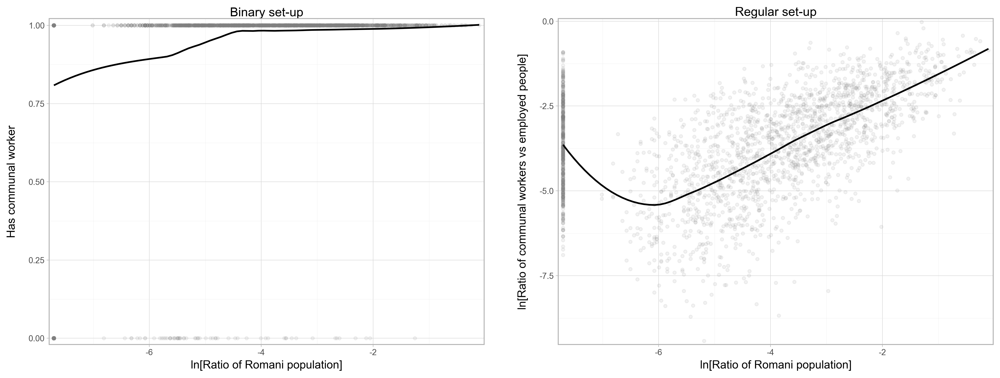

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [490]:
pw.basefigure.clear()
p1 = plot_lowess(train, 'ln_romani_ratio', 'has_comm_worker', 'ln[Ratio of Romani population]', 'Has communal worker', 'Binary set-up', 0.5)
p2 = plot_lowess(train[train['has_comm_worker'] == 1], 'ln_romani_ratio', 'ln_comm_work_per_employed', 'ln[Ratio of Romani population]',
                 'ln[Ratio of communal workers vs employed people]', 'Regular set-up', 0.5)
p1 = pw.load_ggplot(p1)
p2 = pw.load_ggplot(p2)
combined = p1|p2
display(combined)

Now let's also plot some lowess estimates for the other covariates for the two set-ups.

In [493]:
vars_to_plot = ['unemp_ratio','hprest_emp_ratio','agr_emp_ratio','migration_per1000','growth_decline_per1000','max_elem_educ_ratio',
                'disadv_elem_students_ratio','elem_stud_from_other_muni_ratio','county_center_min','low_comf_housing_ratio','crime_per1000people',
                'ln_monthly_income_pc','ln_pop_density','ln_old_age_dependency_ratio','ln_gen_dependency_ratio','ln_avg_gp_visits_pc',
                'ln_pop','ln_area']
labels = ['Unemployment ratio', 'Employment in high-prestige occupations (ratio of employed)', 'Employment in agriculture (ratio of employed)',
          'Migration per mille', 'Natural pop. growth / decline per mille', 'Ratio of pop. with max. elem. education',
          'Ratio of disadv. elementary students', 'Ratio of elementary students from other municipalites', 'Minutes to drive to the county center',
          'Ratio of low comfort housing', 'Crimes commited per 1K inhabitants', 'ln[Monthly income per capita (HUF)]', 'ln[Population density]',
          'ln[Old age dependency ratio]', 'ln[General dependency ratio]', 'ln[Avg. GP visits per capita]', 'ln[Population]', 'ln[Area (km2)]'
         ]

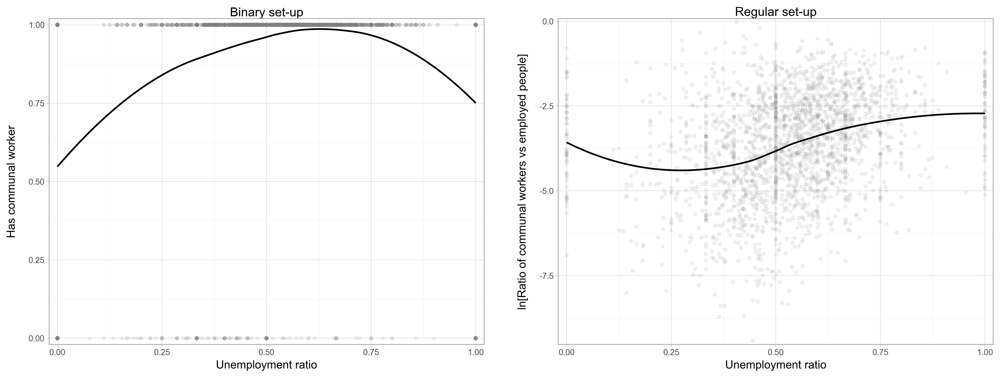

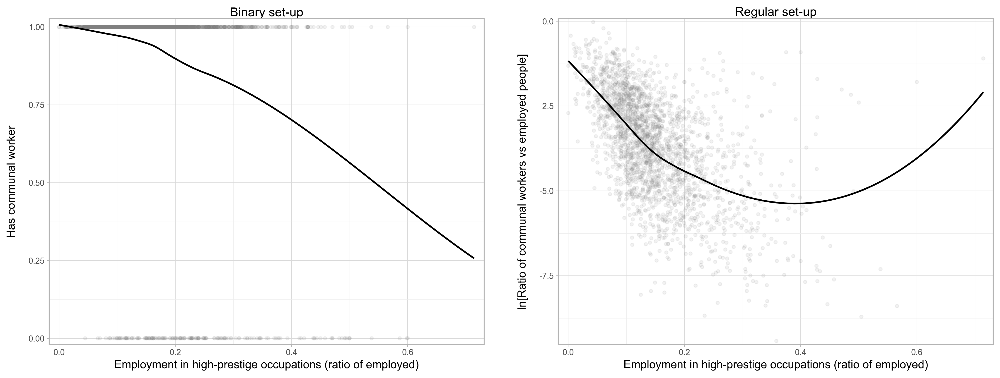

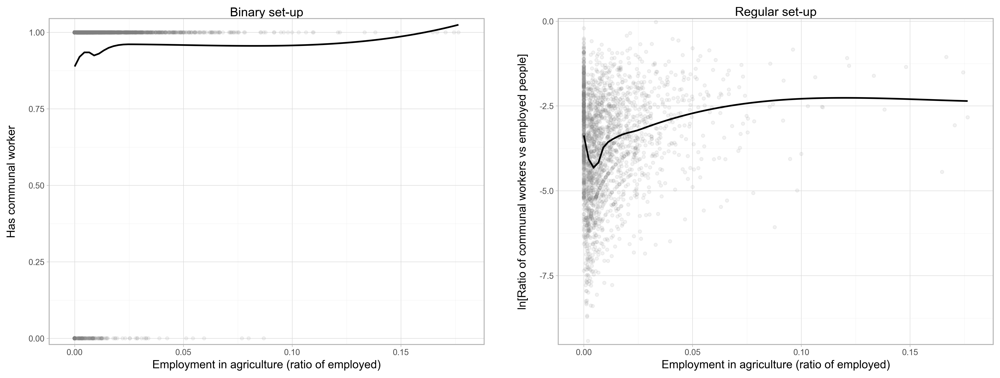

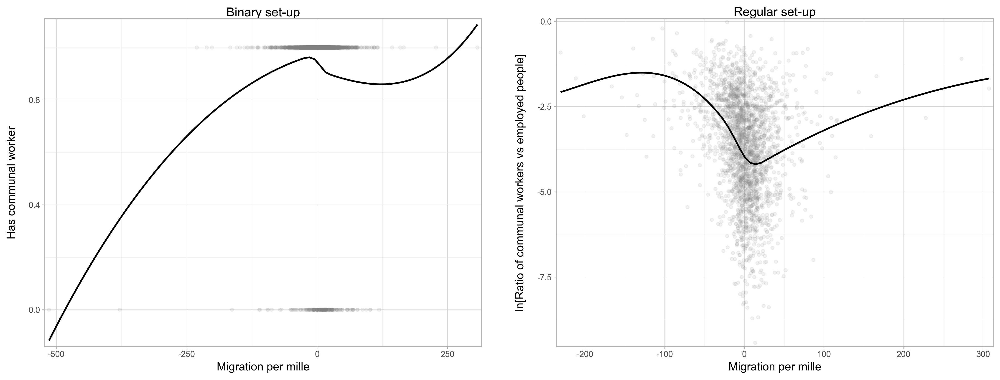

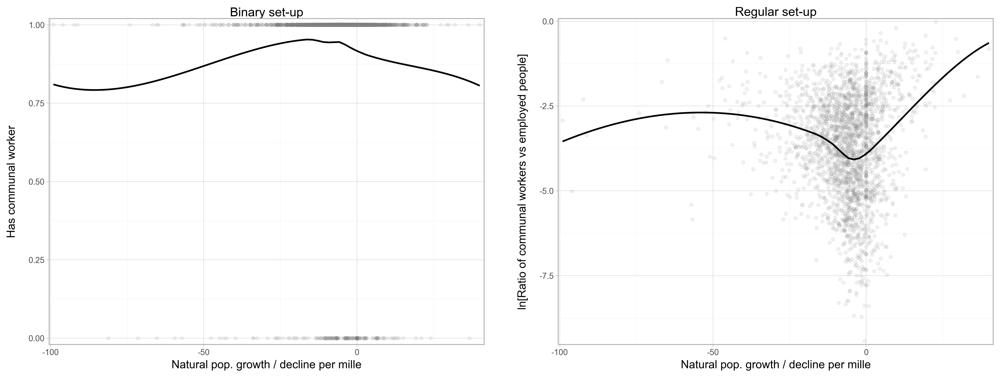

...

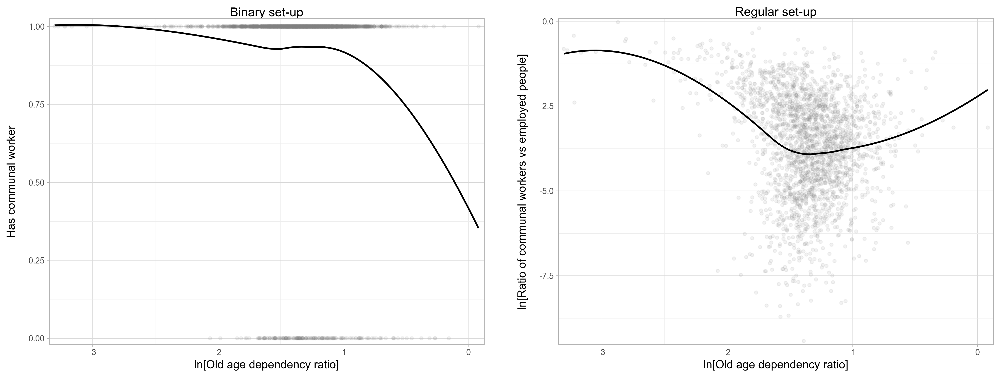

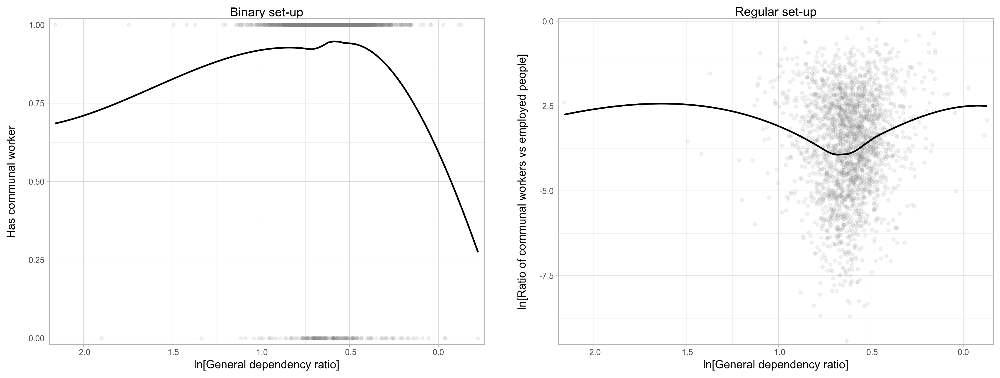

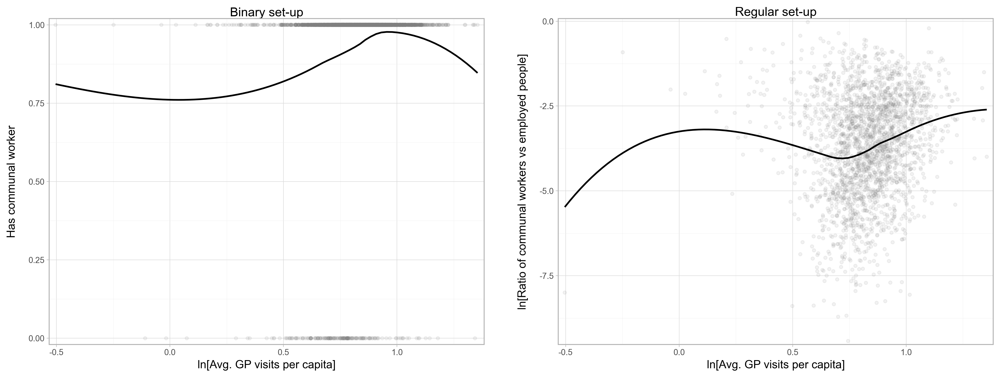

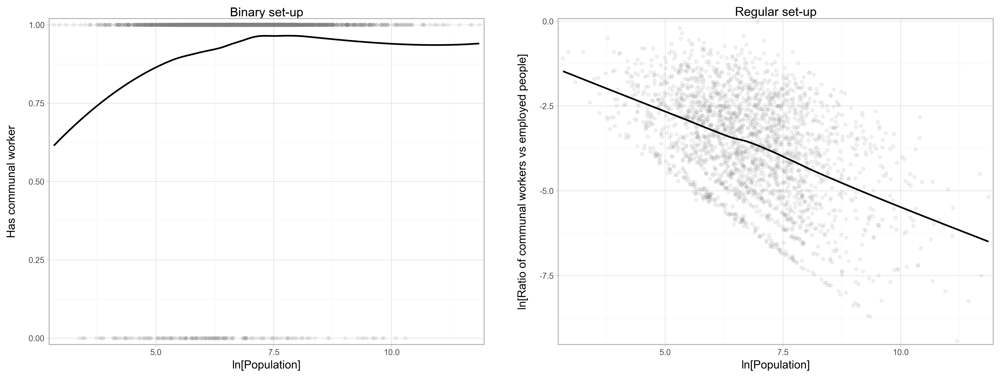

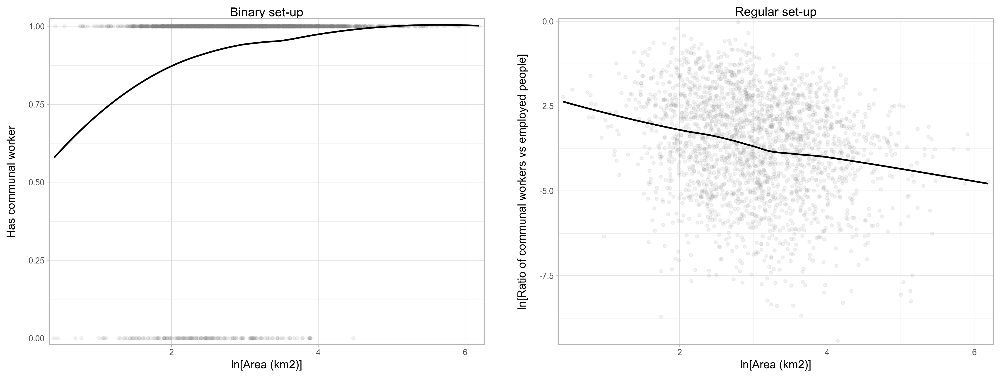

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [495]:
for i in range(len(labels)):
    pw.basefigure.clear()
    p1 = plot_lowess(train, vars_to_plot[i], 'has_comm_worker', labels[i], 'Has communal worker', 'Binary set-up', 0.75)
    p2 = plot_lowess(train[train['has_comm_worker'] == 1], vars_to_plot[i], 'ln_comm_work_per_employed', labels[i],
                     'ln[Ratio of communal workers vs employed people]', 'Regular set-up', 0.75)
    p1 = pw.load_ggplot(p1)
    p2 = pw.load_ggplot(p2)
    combined = p1|p2
    display(combined)

## Modelling

**Probability models** for the whole train sample, where we predict the probability of the municipality having communal workers

**Linear probability model with one explanatory variable**

The first modell is a simple regression, so the only explanatory variable is romani_ratio. The explanatory power of the modell is quite week, the R squared is 0.015. Based on the intercept: if romani_ratio is zero in a municipality, then we expect to have comm_worker with 91%. Municipalities with one percentage point more romani_ratio are on average 0.38 %point more likely to have comm_workers. We can already see the disadvantage of using linear probability mode, it gets outside of the 0-1 range. The next model will be a logit model, and we will only estimate logit models for multiple probability models later.

In [503]:
simple = smf.ols("has_comm_worker ~ romani_ratio", 
               data=train).fit(cov_type ="HC1")
print(simple.summary())

                            OLS Regression Results                            
Dep. Variable:        has_comm_worker   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     85.38
Date:                Wed, 11 Dec 2024   Prob (F-statistic):           5.08e-20
Time:                        15:02:49   Log-Likelihood:                -162.36
No. Observations:                2522   AIC:                             328.7
Df Residuals:                    2520   BIC:                             340.4
Df Model:                           1                                         
Covariance Type:                  HC1                                         
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        0.9100      0.006    142.089   

In [505]:
#train["pred_simple"] = simple.predict()

In [514]:
#train["weight"] = train.groupby(["romani_ratio","has_comm_worker"])["muni_name"].transform("count")
#train["weight_2"] = train["weight"] / 1000

In [516]:
def plot_regscatter(x, y, prediction, xtitle = None, ytitle = None, title = None):
    return (
        ggplot()
        + geom_point(aes(x=x, y=y),fill="grey",color='grey',alpha=0.1)
        + geom_line(aes(x=x, y=prediction), colour="black", size = 1)
        + labs(x = xtitle if xtitle is not None else x,
               y = ytitle if ytitle is not None else y,
               title = title,
              )
        #+ annotate("text", x=(np.min(x)+0.1)*1.5, y=np.min(prediction)-0.05, label=text, size=8, color = 'black')
        + theme_bw()
    )

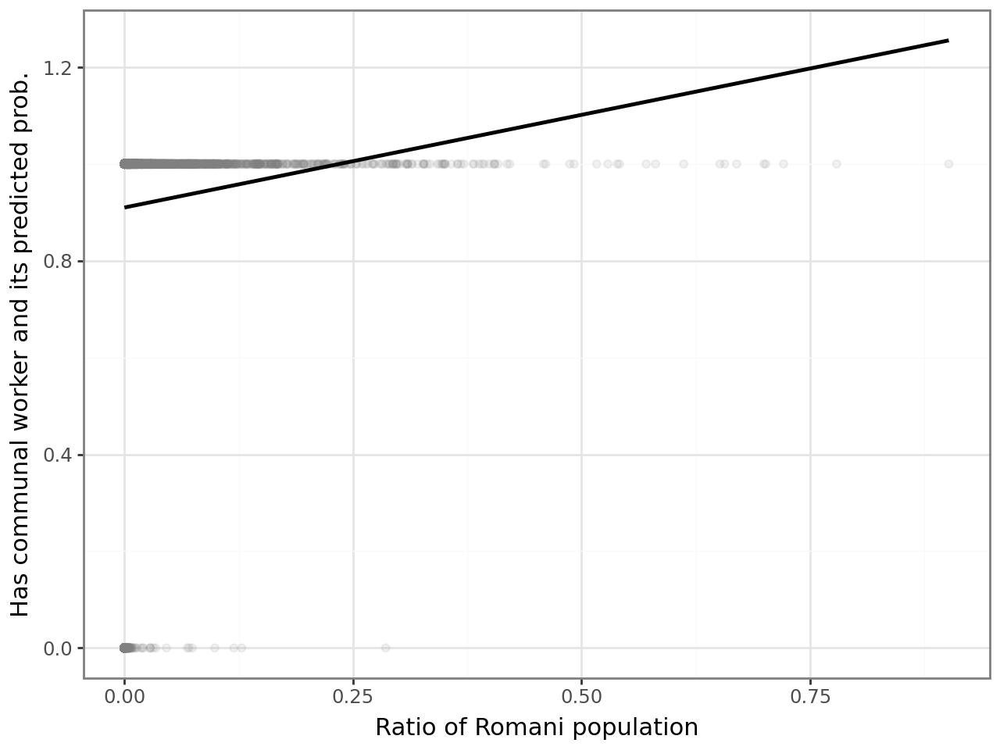

In [519]:
plot_regscatter(train.romani_ratio, train.has_comm_worker, simple.predict(),
                'Ratio of Romani population', 'Has communal worker and its predicted prob.')

We can see on the graph as well that the predictions go outside the 0-1 range.

**Logit model - simple regression**

In [528]:
logit = smf.logit("has_comm_worker ~ romani_ratio", train).fit(cov_type = 'HC1')
table = Stargazer([logit])
table

Optimization terminated successfully.
         Current function value: 0.237838
         Iterations 10


In case of logit models, the coefficient itself doesn't matter that much, we care about the marginal differences more. The marginal difference for the romani ratio is 2.63 which means that municipalities with one percentage point more romani_ratio are on average 2.63 %point more likely to have comm_workers.

In [531]:
logit.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
================================================================================
                  dy/dx    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
romani_ratio     2.6274      0.894      2.940      0.003       0.876       4.379
================================================================================
"""

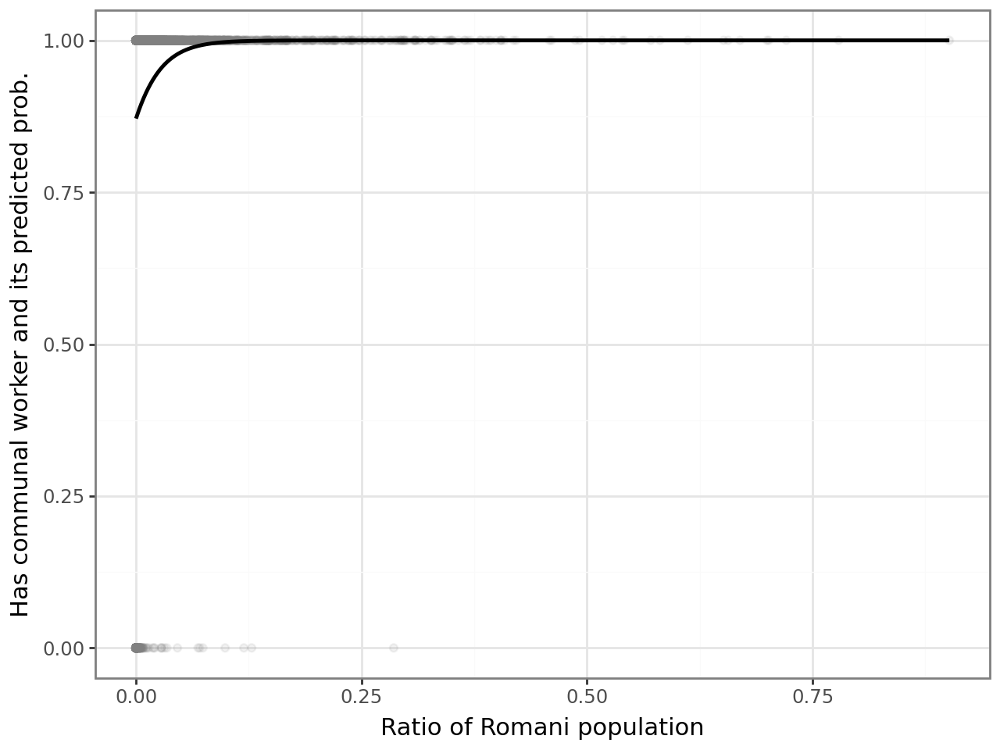

In [533]:
plot_regscatter(train.romani_ratio, train.has_comm_worker, logit.predict(),
                'Ratio of Romani population', 'Has communal worker and its predicted prob.')

Based on the prediction we can see that the intercept is still high. So there probability of having comm_worker is high with 0% romani ratio as well. But the romani_ratio parameters is significant in the model output. The model output stays inside the 0-1 range, even though it reaches the 100% probability quite soon.

From now on I will use only logit regressions insetad of linear probability functions. Based on what we learned in the classes, it doesn't matter if I use logit or probit. I will use logit.

**Logit model: level(has_comm_worker)-log(romani_ratio)**

As we have discussed before, the romani_ratio variable includes observations with the value 0, so we made a flag variable for theses observations and changed their value to a positive but small number. So in each model where we use the logaritm of the romani_ratio we also add their interaction as well.

In [539]:
logit_lev_log = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag", 
               data=train).fit(cov_type ="HC1")
print(logit_lev_log.summary())

Optimization terminated successfully.
         Current function value: 0.222521
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2519
Method:                           MLE   Df Model:                            2
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.1482
Time:                        15:03:34   Log-Likelihood:                -561.20
converged:                       True   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 4.060e-43
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Intercept                            6.2734      0.583     10.76

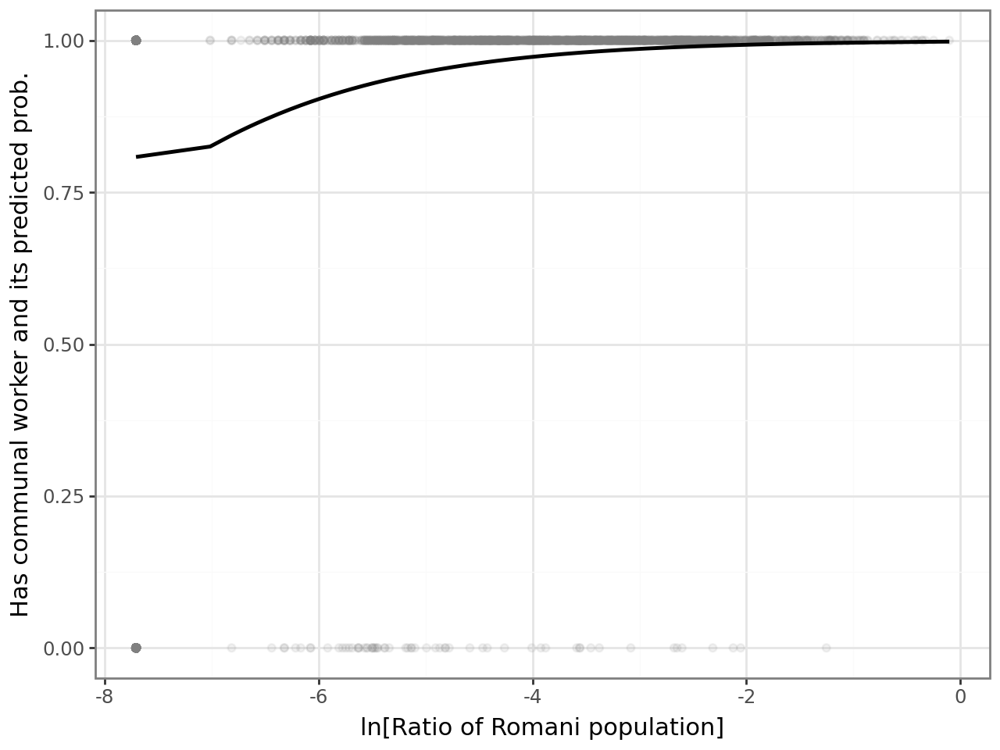

In [541]:
plot_regscatter(train.ln_romani_ratio, train.has_comm_worker, logit_lev_log.predict(),
                'ln[Ratio of Romani population]', 'Has communal worker and its predicted prob.')

**Adding spline to the model**

Based on the lowess function between ln_romani ratio and has_comm_worker it makes sense to try a spline function with a knot at -4.5

In [545]:
def lspline(series, knots):
    def knot_ceil(vector, knot):
        vector_copy = copy.deepcopy(vector)
        vector_copy[vector_copy > knot] = knot
        return vector_copy

    if type(knots) != list:
        knots = [knots]
    design_matrix = None
    vector = series.values

    for i in range(len(knots)):
        # print(i)
        # print(vector)
        if i == 0:
            column = knot_ceil(vector, knots[i])
        else:
            column = knot_ceil(vector, knots[i] - knots[i - 1])
        # print(column)
        if i == 0:
            design_matrix = column
        else:
            design_matrix = np.column_stack((design_matrix, column))
        # print(design_matrix)
        vector = vector - column
    design_matrix = np.column_stack((design_matrix, vector))
    # print(design_matrix)
    return design_matrix

In [546]:
def linear_and_quadratic_design(series: pd.Series, knot: float) -> np.array:
    """
    Generate a design matrix with:
    - A linear segment for the range 0-knot
    - A quadratic value for data bove the knot
    - A linear value for data above the knot

    Parameters:
    series (pd.Series): The input pandas Series.
    knot (float): The threshold value for the transition.

    Returns:
    np.array: The combined design matrix.
    """
    #linear component for range 0-knot
    linear_below_knot = series.apply(lambda x: x if x <= knot else knot).values.reshape(-1, 1)

    #linear segment for values above the knot
    linear_above_knot = series.apply(lambda x: max(0, x - knot)).values.reshape(-1, 1)

    #quadratic component for range 0-knot
    quadratic_above_knot = series.apply(lambda x: (x-knot)**2 if x > knot else 0).values.reshape(-1, 1)

    #combine all components into a single design matrix
    design_matrix = np.hstack((linear_below_knot, linear_above_knot, quadratic_above_knot))
    return design_matrix

In [549]:
logit_spline = smf.logit(
    "has_comm_worker ~ lspline(ln_romani_ratio,[-4.5]) + lspline(ln_romani_ratio,[-4.5])[:,0]:romani_zero_flag", train).fit(cov_type="HC1")
print(logit_spline.summary())

Optimization terminated successfully.
         Current function value: 0.222273
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2518
Method:                           MLE   Df Model:                            3
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.1491
Time:                        15:03:41   Log-Likelihood:                -560.57
converged:                       True   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 2.444e-42
                                                              coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------
Intercept         

In [580]:
logit_spline.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
===========================================================================================================================
                                                             dy/dx    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------
lspline(ln_romani_ratio, [-4.5])[0]                         0.0554      0.012      4.483      0.000       0.031       0.080
lspline(ln_romani_ratio, [-4.5])[1]                         0.0289      0.013      2.238      0.025       0.004       0.054
lspline(ln_romani_ratio, [-4.5])[:, 0]:romani_zero_flag    -0.0067      0.004     -1.686      0.092      -0.014       0.001
===========================================================================================================================
"""

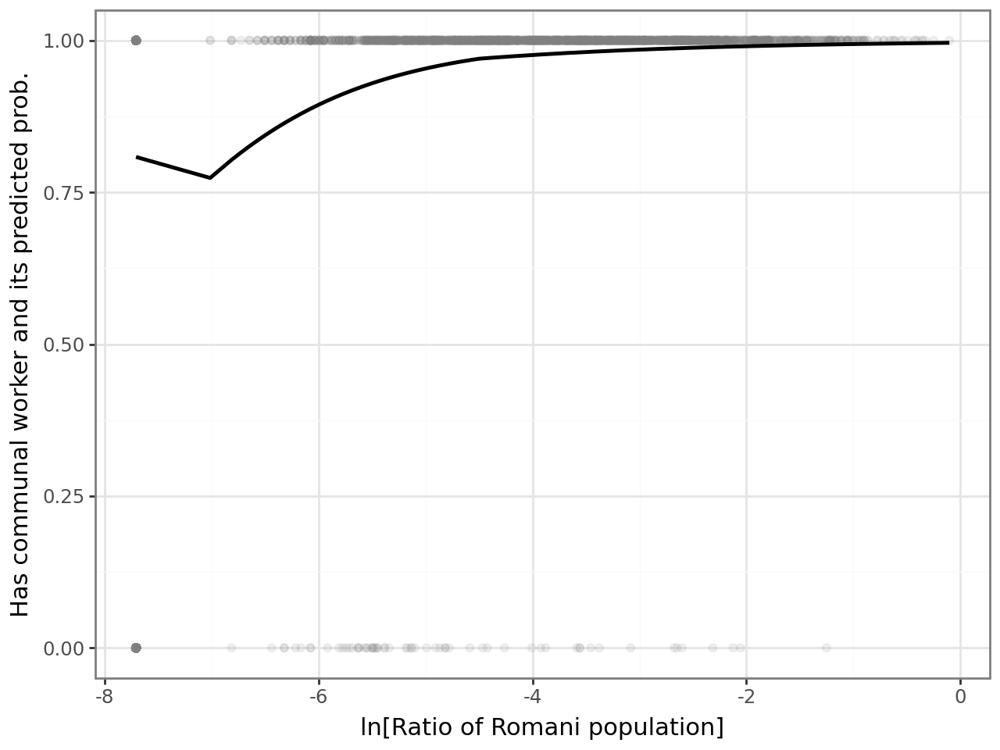

In [553]:
plot_regscatter(train.ln_romani_ratio, train.has_comm_worker, logit_spline.predict(),
                'ln[Ratio of Romani population]', 'Has communal worker and its predicted prob.')

Marginalt valahogy belerakni az összehasonlításba

In [560]:
table = Stargazer([simple, logit, logit_lev_log, logit_spline ])
table.custom_columns(["Simple Model", "Logit Model", "Logit Level-Log", "Logit with Spline"], [1, 1, 1, 1])
table

In [610]:
train['simple_pred'] = simple.predict()
train['logit_pred'] = logit.predict()
train['logit_lev_log'] = logit_lev_log.predict()
train['logit_spline'] = logit_spline.predict()

pd.DataFrame(
    {
        "R-squared": [
            simple.rsquared,
            r2_score(train["has_comm_worker"], train["logit_pred"]),
            r2_score(train["has_comm_worker"], train["logit_lev_log"]),
            r2_score(train["has_comm_worker"], train["logit_spline"]),
        ],
        "Brier-score": [
            mean_squared_error(train["has_comm_worker"], train["simple_pred"]),
            mean_squared_error(train["has_comm_worker"], train["logit_pred"]),
            mean_squared_error(train["has_comm_worker"], train["logit_lev_log"]),
            mean_squared_error(train["has_comm_worker"], train["logit_spline"]),
        ],
        "Pseudo R-squared": [np.nan, logit.prsquared, logit_lev_log.prsquared, logit_spline.prsquared],
        "Log-loss": [
            -1 * log_loss(train["has_comm_worker"], train["simple_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["logit_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["logit_lev_log"]),
            -1 * log_loss(train["has_comm_worker"], train["logit_spline"]),
        ],
    },
    index=["Simple Model", "Logit Model", "Logit Level-Log", "Logit with Spline"],
).T.round(3)



,Simple Model,Logit Model,Logit Level-Log,Logit with Spline
R-squared,0.015,0.055,0.081,0.080
Brier-score,0.067,0.064,0.062,0.062
Pseudo R-squared,NaN,0.090,0.148,0.149
Log-loss,-0.263,-0.238,-0.223,-0.222


In [612]:
train = train.drop(columns=['simple_pred', 'logit_pred', 'logit_lev_log', 'logit_spline'])

## Multiple Regression models

**Level level logit model, inculding all explanatory variables**

In [614]:
multiple_level = smf.logit("has_comm_worker ~ romani_ratio+" #main variables
                           "max_elem_educ_ratio+disadv_elem_students_ratio+elem_stud_from_other_muni_ratio++no_elem_stud+" #variables about education
                           "low_comf_housing_ratio+crime_per1000people+avg_gp_visits_pc+" #variables about safety and health
                           "migration_per1000+growth_decline_per1000+county_center_min+" #migration and mobility
                           "monthly_income_pc+unemp_ratio+hprest_emp_ratio+agr_emp_ratio+" #job composition
                           "gen_dependency_ratio+old_age_dependency_ratio+" #demography
                           "is_county_center+pop_density", 
               data=train).fit(cov_type ="HC1")
print(multiple_level.summary())

         Current function value: 0.184711
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2502
Method:                           MLE   Df Model:                           19
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.2929
Time:                        15:48:30   Log-Likelihood:                -465.84
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 3.676e-70
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                           0.3685      1.186      0.311      0.756      -1.956       2.693
ro

In [616]:
multiple_level.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
===================================================================================================
                                     dy/dx    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
romani_ratio                        0.4026      0.249      1.617      0.106      -0.085       0.891
max_elem_educ_ratio                 0.3173      0.102      3.123      0.002       0.118       0.516
disadv_elem_students_ratio          2.4326      0.698      3.487      0.000       1.065       3.800
elem_stud_from_other_muni_ratio     0.0542      0.041      1.315      0.189      -0.027       0.135
no_elem_stud                       -0.0123      0.017     -0.719      0.472      -0.046       0.021
low_comf_housing_ratio              0.1415      0.095      1.491      0.136      -0.044       0.327
crime_per1000people             -5.014e-05      0.000     -0.125      0.900      -0.001       0.001
avg_gp_visits_pc                    0.0462      0.016      2.926      0.003       0.015       0.077
migration_per1000                8.881e-05      0.000      0.743      0.457      -0.000       0.000
growth_decline_per1000             -0.0003      0.001     -0.653      0.514      -0.001       0.001
county_center_min                  -0.0002      0.000     -0.882      0.378      -0.001       0.000
monthly_income_pc               -2.531e-07   2.21e-07     -1.143      0.253   -6.87e-07    1.81e-07
unemp_ratio                         0.1118      0.024      4.661      0.000       0.065       0.159
hprest_emp_ratio                   -0.2066      0.072     -2.870      0.004      -0.348      -0.065
agr_emp_ratio                       0.0849      0.364      0.233      0.815      -0.628       0.798
gen_dependency_ratio               -0.0432      0.076     -0.569      0.569      -0.192       0.106
old_age_dependency_ratio           -0.1332      0.076     -1.753      0.080      -0.282       0.016
is_county_center                    1.1775      0.074     15.874      0.000       1.032       1.323
pop_density                      4.278e-05    3.3e-05      1.297      0.195   -2.19e-05       0.000
===================================================================================================
"""

**Taking the logarithm of the romani_ratio**

In [619]:
multiple_lnromani = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag+"
                              "max_elem_educ_ratio+disadv_elem_students_ratio+elem_stud_from_other_muni_ratio++no_elem_stud+" #variables about education
                           "low_comf_housing_ratio+crime_per1000people+avg_gp_visits_pc+" #variables about safety and health
                           "migration_per1000+growth_decline_per1000+county_center_min+" #migration and mobility
                           "monthly_income_pc+unemp_ratio+hprest_emp_ratio+agr_emp_ratio+" #job composition
                           "gen_dependency_ratio+old_age_dependency_ratio+" #demography
                           "is_county_center+pop_density", 
               data=train).fit(cov_type ="HC1")
print(multiple_lnromani.summary())

         Current function value: 0.179375
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2501
Method:                           MLE   Df Model:                           20
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.3133
Time:                        15:48:34   Log-Likelihood:                -452.38
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 4.404e-75
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Intercept                            0.3450      1.376      0.251      0.802      -2.352       3.042

In [620]:
multiple_lnromani.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
====================================================================================================
                                      dy/dx    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
ln_romani_ratio                     -0.0030      0.008     -0.384      0.701      -0.018       0.012
ln_romani_ratio:romani_zero_flag     0.0095      0.004      2.708      0.007       0.003       0.016
max_elem_educ_ratio                  0.2956      0.094      3.143      0.002       0.111       0.480
disadv_elem_students_ratio           2.2544      0.635      3.551      0.000       1.010       3.499
elem_stud_from_other_muni_ratio      0.0756      0.037      2.041      0.041       0.003       0.148
no_elem_stud                         0.0269      0.018      1.496      0.135      -0.008       0.062
low_comf_housing_ratio               0.1429      0.089      1.601      0.109      -0.032       0.318
crime_per1000people              -6.824e-05      0.000     -0.176      0.860      -0.001       0.001
avg_gp_visits_pc                     0.0403      0.015      2.685      0.007       0.011       0.070
migration_per1000                 7.292e-05      0.000      0.636      0.525      -0.000       0.000
growth_decline_per1000              -0.0004      0.000     -0.905      0.365      -0.001       0.000
county_center_min                   -0.0002      0.000     -0.576      0.564      -0.001       0.000
monthly_income_pc                -2.341e-07   2.11e-07     -1.108      0.268   -6.48e-07     1.8e-07
unemp_ratio                          0.1002      0.022      4.517      0.000       0.057       0.144
hprest_emp_ratio                    -0.1920      0.068     -2.824      0.005      -0.325      -0.059
agr_emp_ratio                        0.2047      0.349      0.586      0.558      -0.480       0.889
gen_dependency_ratio                -0.0315      0.069     -0.457      0.647      -0.167       0.104
old_age_dependency_ratio            -0.1175      0.071     -1.651      0.099      -0.257       0.022
is_county_center                     0.8475      0.057     14.968      0.000       0.736       0.958
pop_density                       1.519e-05    2.9e-05      0.525      0.600   -4.16e-05    7.19e-05
====================================================================================================
"""

Many of our variables are **proxy variables** for the well being of the municipality which can cause **multicollinearity**. For the better understanding I visualize the correlation between the variables. In case of proxy variables, it is common method to use **Pricipal component analysis**.

## Collinearity analysis

In [625]:
non_binary_variables = [
    "ln_romani_ratio", "ln_monthly_income_pc", "unemp_ratio", "hprest_emp_ratio", "agr_emp_ratio", 
    "ln_pop_density", "ln_old_age_dependency_ratio", "ln_gen_dependency_ratio", "migration_per1000", 
    "growth_decline_per1000", "max_elem_educ_ratio", "disadv_elem_students_ratio", 
    "elem_stud_from_other_muni_ratio", "county_center_min", "low_comf_housing_ratio", 
    "crime_per1000people", "ln_avg_gp_visits_pc", "ln_pop", "ln_area"
]

df_selected = train[non_binary_variables]

# Compute the correlation matrix
correlation_matrix = df_selected.corr()
correlation_matrix.round(2)

,ln_romani_ratio,ln_monthly_income_pc,unemp_ratio,hprest_emp_ratio,agr_emp_ratio,ln_pop_density,ln_old_age_dependency_ratio,ln_gen_dependency_ratio,migration_per1000,growth_decline_per1000,max_elem_educ_ratio,disadv_elem_students_ratio,elem_stud_from_other_muni_ratio,county_center_min,low_comf_housing_ratio,crime_per1000people,ln_avg_gp_visits_pc,ln_pop,ln_area
ln_romani_ratio,1.00,-0.44,0.19,-0.37,0.03,0.14,-0.37,0.02,-0.10,0.17,0.48,0.37,0.03,0.11,0.22,0.17,0.14,0.24,0.22
ln_monthly_income_pc,-0.44,1.00,-0.22,0.55,-0.21,0.40,0.22,-0.12,0.18,-0.01,-0.73,-0.22,0.20,-0.28,-0.37,-0.20,0.11,0.35,0.12
unemp_ratio,0.19,-0.22,1.00,-0.15,0.07,-0.10,-0.04,-0.03,-0.08,-0.05,0.24,0.12,-0.02,0.12,0.14,0.08,0.06,-0.06,0.01
hprest_emp_ratio,-0.37,0.55,-0.15,1.00,-0.24,0.30,0.26,0.11,0.10,-0.04,-0.69,-0.21,0.13,-0.18,-0.28,-0.05,-0.10,0.22,0.02
agr_emp_ratio,0.03,-0.21,0.07,-0.24,1.00,-0.24,-0.01,0.07,-0.04,0.04,0.26,0.01,-0.08,0.09,0.15,-0.03,-0.04,-0.15,0.02
ln_pop_density,0.14,0.40,-0.10,0.30,-0.24,1.00,-0.15,-0.01,0.09,0.20,-0.36,0.11,0.22,-0.19,-0.20,-0.01,0.10,0.77,0.13
ln_old_age_dependency_ratio,-0.37,0.22,-0.04,0.26,-0.01,-0.15,1.00,0.48,0.05,-0.43,-0.31,-0.15,0.07,0.06,-0.18,-0.08,0.22,-0.06,0.07
ln_gen_dependency_ratio,0.02,-0.12,-0.03,0.11,0.07,-0.01,0.48,1.00,0.07,-0.13,-0.03,0.03,0.05,0.09,-0.01,0.06,0.16,0.07,0.11
migration_per1000,-0.10,0.18,-0.08,0.10,-0.04,0.09,0.05,0.07,1.00,-0.05,-0.14,-0.07,0.01,-0.07,-0.10,-0.03,0.01,0.08,0.03
growth_decline_per1000,0.17,-0.01,-0.05,-0.04,0.04,0.20,-0.43,-0.13,-0.05,1.00,0.04,0.09,0.02,-0.09,0.01,0.01,-0.18,0.15,0.02


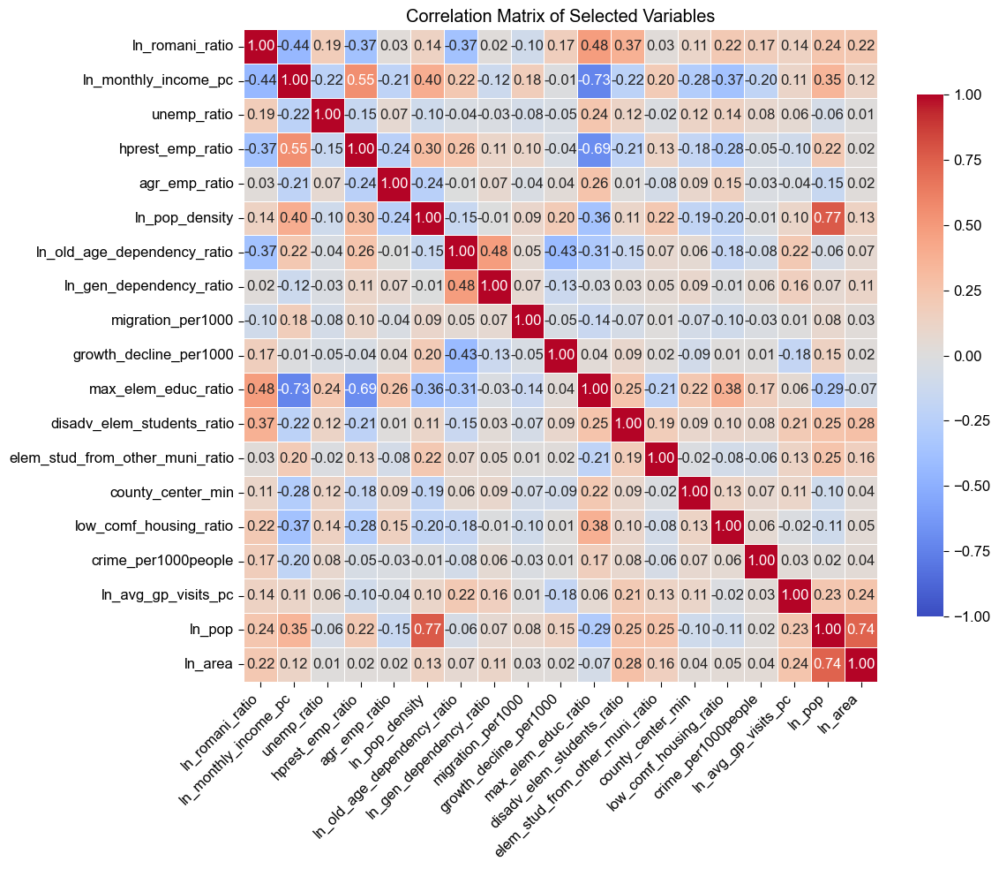

In [627]:
# Plot the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix, 
    annot=True, fmt=".2f", cmap="coolwarm", 
    vmin=-1, vmax=1, linewidths=0.5, cbar_kws={"shrink": 0.8}
)
plt.title("Correlation Matrix of Selected Variables")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [628]:
for i in np.arange(0.3, 1, 0.1):
    filtered_pairs = (
        correlation_matrix
        .stack()
        .reset_index()
    )
    filtered_pairs.columns = ['Var1', 'Var2', 'Corr']
    
    filtered_pairs[['Var1', 'Var2']] = (
        filtered_pairs[['Var1', 'Var2']]
        .apply(lambda x: sorted(x), axis=1, result_type='expand')
    )
    result = filtered_pairs[
        (filtered_pairs['Corr'] >= i) & 
        (filtered_pairs['Corr'] < i+0.1) & 
        (filtered_pairs['Var1'] != filtered_pairs['Var2'])
    ].drop_duplicates()

    if result.shape[0] != 0:
        print(f'Variables with correlation between {round(i,1)} and {round(i+0.1,1)}:')
        print('*'*60)
        print(result)
        print(f'{"*"*60}\n\n')
    

Variables with correlation between 0.3 and 0.4:
************************************************************
                           Var1                 Var2      Corr
11   disadv_elem_students_ratio      ln_romani_ratio  0.374269
24         ln_monthly_income_pc       ln_pop_density  0.395231
36         ln_monthly_income_pc               ln_pop  0.349464
62             hprest_emp_ratio       ln_pop_density  0.303635
204      low_comf_housing_ratio  max_elem_educ_ratio  0.378583
************************************************************


Variables with correlation between 0.4 and 0.5:
************************************************************
                        Var1                         Var2      Corr
10           ln_romani_ratio          max_elem_educ_ratio  0.477813
121  ln_gen_dependency_ratio  ln_old_age_dependency_ratio  0.483027
************************************************************


Variables with correlation between 0.5 and 0.6:
**************************

## Principal Component Analysis

For principal component analysis it is important to scale the variables first.

In [633]:
variables_to_scale = [
     "ln_monthly_income_pc", "unemp_ratio", "hprest_emp_ratio", "agr_emp_ratio", 
    "ln_pop_density", "ln_old_age_dependency_ratio", "ln_gen_dependency_ratio", "migration_per1000", 
    "growth_decline_per1000", "max_elem_educ_ratio", "disadv_elem_students_ratio", 
    "elem_stud_from_other_muni_ratio", "county_center_min", "low_comf_housing_ratio", 
    "crime_per1000people", "ln_avg_gp_visits_pc", "ln_pop", "ln_area"
]

for var in variables_to_scale:
    train[f"scaled_{var}"] = (train[var] - train[var].mean()) / train[var].std()
    test[f"scaled_{var}"] = (test[var] - train[var].mean()) / train[var].std()

# Check the result
train.head()


,muni_id,muni_name,status,is_county_center,county,district,comm_work_per_employed,romani_ratio,monthly_income_pc,unemp_ratio,...,scaled_growth_decline_per1000,scaled_max_elem_educ_ratio,scaled_disadv_elem_students_ratio,scaled_elem_stud_from_other_muni_ratio,scaled_county_center_min,scaled_low_comf_housing_ratio,scaled_crime_per1000people,scaled_ln_avg_gp_visits_pc,scaled_ln_pop,scaled_ln_area
1297,383,Keszü,község,0,Baranya,Pécsi,0.012839,0.0095,225061.853359,0.4286,...,1.054404,-1.424421,-0.536982,-0.646008,-1.557893,-0.311408,-0.237790,-0.681450,0.382970,-1.153930
2314,451,Rózsafa,község,0,Baranya,Szigetvári,0.070922,0.1610,84497.613636,0.5625,...,1.881225,1.460007,-0.536982,-0.646008,-0.550925,-0.699686,0.818184,-0.089333,-0.669054,-0.186046
765,758,Felsőregmec,község,0,Borsod-Abaúj-Zemplén,Sátoraljaújhelyi,0.403846,0.6696,51847.948052,0.6136,...,3.111165,2.823077,-0.536982,-0.646008,2.160669,3.042651,-0.779595,-0.707398,-0.624222,-0.700135
2954,1458,Vámosgyörk,község,0,Heves,Gyöngyösi,0.016260,0.0146,184430.903537,0.5946,...,-2.007579,-0.449161,-0.417133,0.370783,0.198935,0.015500,-0.186155,1.478866,0.628476,0.132851
2808,337,Tiszapüspöki,község,0,Jász-Nagykun-Szolnok,Törökszentmiklósi,0.069393,0.1532,113463.144541,0.4722,...,0.801383,0.700044,2.761736,-0.646008,-1.083193,0.417940,0.097474,-0.413901,0.660664,0.768461


In [635]:
def pca_train_test(train, test, columns_to_use):
    pca = PCA(n_components = 1)
    tr = pca.fit_transform(train[columns_to_use])
    ts = pca.transform(test[columns_to_use])
    return tr, ts

In [637]:
columns_to_use = [
                  ["scaled_low_comf_housing_ratio", "scaled_crime_per1000people", "scaled_ln_avg_gp_visits_pc"], #pca_health_safety
                  ["scaled_migration_per1000", "scaled_growth_decline_per1000", "scaled_county_center_min"], #pca_migration_moblility
                  ["scaled_ln_monthly_income_pc", "scaled_unemp_ratio", "scaled_hprest_emp_ratio", "scaled_agr_emp_ratio"], #pca_job_comp
                  ["scaled_ln_old_age_dependency_ratio", "scaled_ln_gen_dependency_ratio"], #pca_demog
                  ['scaled_ln_pop_density', 'scaled_ln_pop'] #pca_popsize
                 ]
out_col_names = [ 'pca_health_safety', 'pca_migration_moblility', 'pca_job_comp', 'pca_demog', 'pca_popsize']

for i in range(len(out_col_names)):
    tr, ts = pca_train_test(train, test, columns_to_use[i])
    train[out_col_names[i]] = tr
    test[out_col_names[i]] = ts

első sort kibontani, disadv nem kell, other muni nem kell

In [640]:
pca = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag+"
                "is_county_center+no_elem_stud+max_elem_educ_ratio+"
                "pca_health_safety+pca_migration_moblility+pca_job_comp+pca_demog+pca_popsize", 
               data=train).fit(cov_type ="HC1")
print(pca.summary())

         Current function value: 0.192262
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2511
Method:                           MLE   Df Model:                           10
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.2640
Time:                        15:49:32   Log-Likelihood:                -484.89
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 1.143e-68
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Intercept                            3.4516      0.917      3.762      0.000       1.653       5.250

In [642]:
pca.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
====================================================================================================
                                      dy/dx    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
ln_romani_ratio                      0.0098      0.008      1.267      0.205      -0.005       0.025
ln_romani_ratio:romani_zero_flag     0.0049      0.003      1.439      0.150      -0.002       0.012
is_county_center                     1.1585      0.072     16.002      0.000       1.017       1.300
no_elem_stud                        -0.0403      0.013     -3.062      0.002      -0.066      -0.014
max_elem_educ_ratio                  0.2947      0.106      2.782      0.005       0.087       0.502
pca_health_safety                    0.0120      0.007      1.759      0.079      -0.001       0.025
pca_migration_moblility              0.0020      0.006      0.371      0.711      -0.009       0.013
pca_job_comp                        -0.0339      0.005     -6.596      0.000      -0.044      -0.024
pca_demog                            0.0065      0.004      1.510      0.131      -0.002       0.015
pca_popsize                          0.0038      0.006      0.681      0.496      -0.007       0.015
====================================================================================================
"""

The interpretation of the components is not straigforward as they include variables that we suppose that has positive effect on the wealth of the municipality, and variables that has negative effect. For example job composition component includes high_prest_emp_ratio, the higher the better wealth we suppose, and unemp ratio which indicates negative effect on wealth. So now we will make more sophisticated categories.

**Model with more sophisticated principal components**

1. Education positive: elem_stud_from_other_muni_ratio
2. Education negative:
    max_elem_educ_ratio
    disadv_elem_students_ratio
    

3. Health and safety negative
    low_comf_housing_ratio
    crime_per1000people
    avg_gp_visits_pc

4. migration and mobility positive
    migration_per1000
    growth_decline_per1000
    pop_density
   
6. migration and mobility negative
    county_center_min
    
7. job composition and status positive
    monthly_income_pc
    hprest_emp_ratio
   
9. job composition and status negative
    unemp_ratio
    agr_emp_ratio
   
10. demographic composition
    old_age_dependency_ratio
    gen_dependency_ratio

In [647]:
'''train = train[["muni_name", "status", "is_county_center", "county", "district", "comm_work_per_employed", "romani_ratio", "monthly_income_pc", "unemp_ratio", "hprest_emp_ratio",
              "agr_emp_ratio", "pop_density", "old_age_dependency_ratio", "gen_dependency_ratio", "migration_per1000", "growth_decline_per1000", "max_elem_educ_ratio", "disadv_elem_students_ratio",
               "elem_stud_from_other_muni_ratio", "county_center_min", "low_comf_housing_ratio", "crime_per1000people", "avg_gp_visits_pc", "no_elem_stud", "ln_romani_ratio", "romani_zero_flag",
              "has_comm_worker", "scaled_monthly_income_pc", "scaled_unemp_ratio", "scaled_hprest_emp_ratio", "scaled_agr_emp_ratio", "scaled_pop_density", "scaled_old_age_dependency_ratio",
               "scaled_gen_dependency_ratio", "scaled_migration_per1000", "scaled_growth_decline_per1000","scaled_max_elem_educ_ratio", "scaled_disadv_elem_students_ratio", "scaled_elem_stud_from_other_muni_ratio",
               "scaled_county_center_min", "scaled_low_comf_housing_ratio", "scaled_crime_per1000people", "scaled_avg_gp_visits_pc"]]'''

'train = train[["muni_name", "status", "is_county_center", "county", "district", "comm_work_per_employed", "romani_ratio", "monthly_income_pc", "unemp_ratio", "hprest_emp_ratio",\n              "agr_emp_ratio", "pop_density", "old_age_dependency_ratio", "gen_dependency_ratio", "migration_per1000", "growth_decline_per1000", "max_elem_educ_ratio", "disadv_elem_students_ratio",\n               "elem_stud_from_other_muni_ratio", "county_center_min", "low_comf_housing_ratio", "crime_per1000people", "avg_gp_visits_pc", "no_elem_stud", "ln_romani_ratio", "romani_zero_flag",\n              "has_comm_worker", "scaled_monthly_income_pc", "scaled_unemp_ratio", "scaled_hprest_emp_ratio", "scaled_agr_emp_ratio", "scaled_pop_density", "scaled_old_age_dependency_ratio",\n               "scaled_gen_dependency_ratio", "scaled_migration_per1000", "scaled_growth_decline_per1000","scaled_max_elem_educ_ratio", "scaled_disadv_elem_students_ratio", "scaled_elem_stud_from_other_muni_ratio",\n               "s

In [649]:
columns_to_use = [
    ["scaled_low_comf_housing_ratio", "scaled_crime_per1000people", "scaled_ln_avg_gp_visits_pc"], #pca_health_safety
    ["scaled_migration_per1000", "scaled_growth_decline_per1000"], #pca_migration_moblility
    ["scaled_ln_monthly_income_pc", "scaled_hprest_emp_ratio"], #pca_job_comp_pos
    ["scaled_unemp_ratio", "scaled_agr_emp_ratio"], #pca_job_comp_neg
    ["scaled_ln_old_age_dependency_ratio", "scaled_ln_gen_dependency_ratio"], #pca_demog
    ['scaled_ln_pop_density', 'scaled_ln_pop'] #pca_popsize
]

out_col_names = [ 'pca_health_safety', 'pca_migration_moblility', 'pca_job_comp_pos', 'pca_job_comp_neg', 'pca_demog', 'pca_popsize']

for i in range(len(out_col_names)):
    tr, ts = pca_train_test(train, test, columns_to_use[i])
    train[out_col_names[i]] = tr
    test[out_col_names[i]] = ts

When we say job_comp_pos we think that these variables would have a positive effect on the wealth.

In [652]:
vars_to_plot = out_col_names

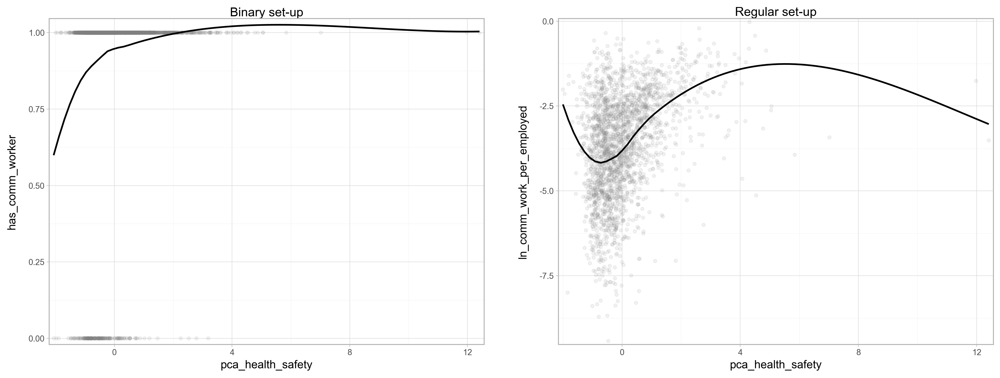

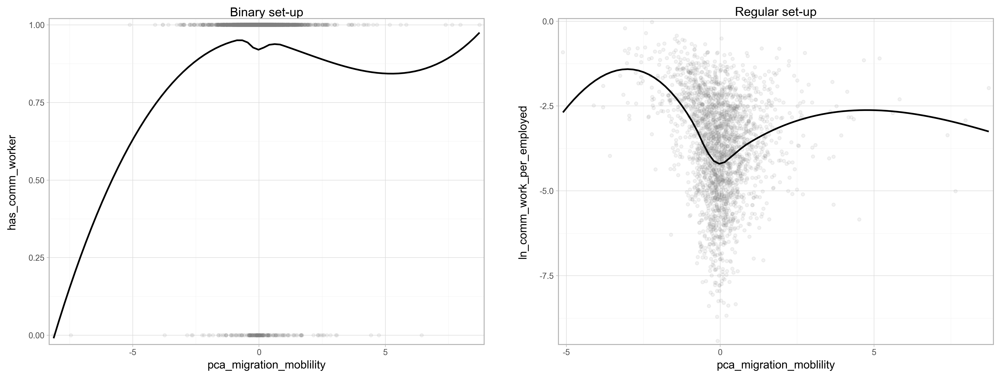

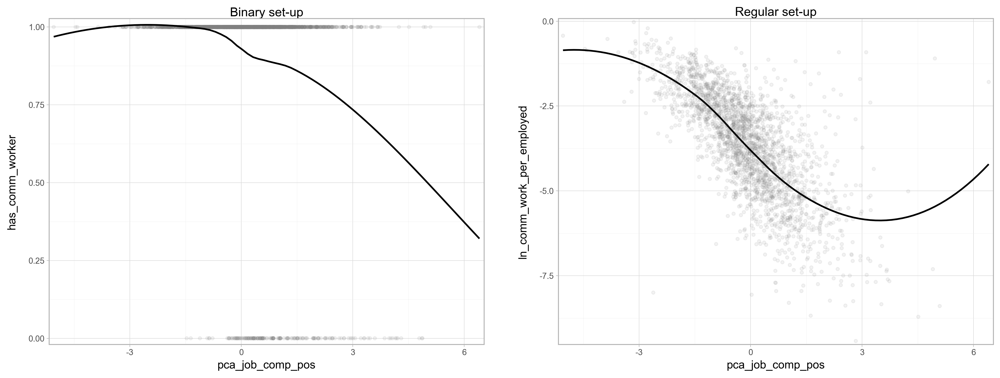

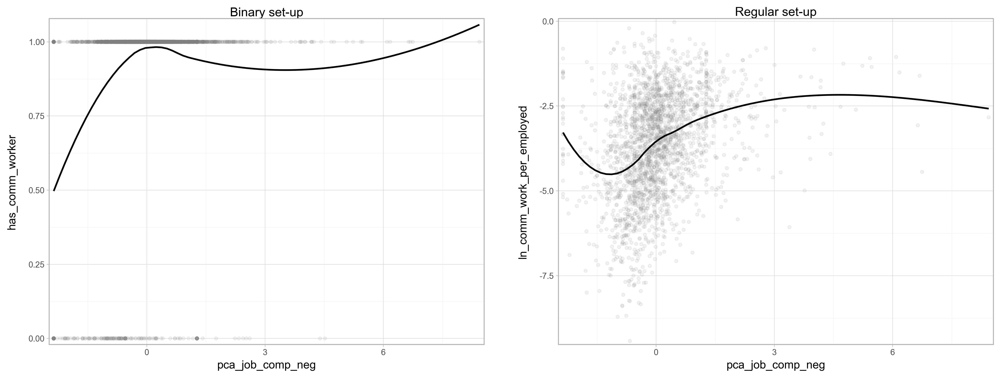

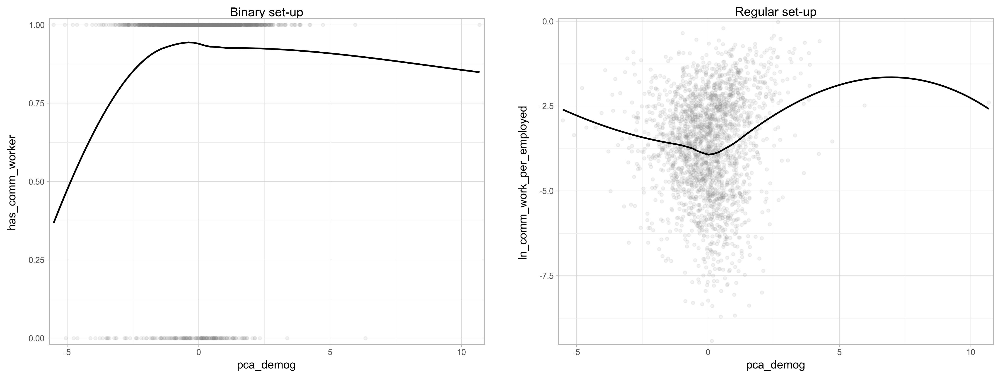

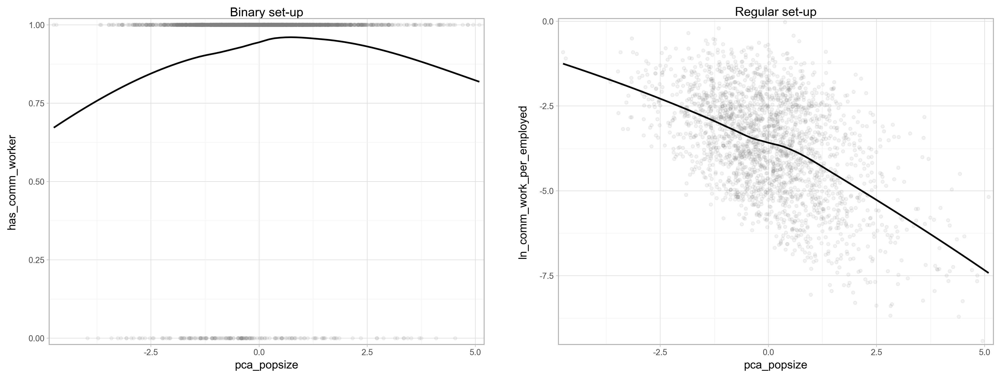

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [654]:
for i in range(len(vars_to_plot)):
    pw.basefigure.clear()
    p1 = plot_lowess(train, vars_to_plot[i], 'has_comm_worker', title='Binary set-up')
    p2 = plot_lowess(train[train['has_comm_worker'] == 1], vars_to_plot[i],'ln_comm_work_per_employed', title = 'Regular set-up')
    p1 = pw.load_ggplot(p1)
    p2 = pw.load_ggplot(p2)
    combined = p1|p2
    display(combined)

**Model with more sophisticated pca-s**

In [656]:
pca_positive_negative = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag+"
                                  "is_county_center+no_elem_stud+elem_stud_from_other_muni_ratio+county_center_min+"
                                  "pca_health_safety+pca_migration_moblility+pca_job_comp_pos+pca_job_comp_neg+pca_demog+pca_popsize", 
               data=train).fit(cov_type ="HC1")
print(pca_positive_negative.summary())

         Current function value: 0.192840
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2509
Method:                           MLE   Df Model:                           12
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.2618
Time:                        15:50:47   Log-Likelihood:                -486.34
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 1.646e-66
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Intercept                            4.8319      0.754      6.407      0.000       3.354       6.310

In [657]:
pca_positive_negative.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
====================================================================================================
                                      dy/dx    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
ln_romani_ratio                      0.0132      0.008      1.727      0.084      -0.002       0.028
ln_romani_ratio:romani_zero_flag     0.0042      0.003      1.256      0.209      -0.002       0.011
is_county_center                     1.7902      0.098     18.207      0.000       1.598       1.983
no_elem_stud                        -0.0199      0.017     -1.137      0.255      -0.054       0.014
elem_stud_from_other_muni_ratio      0.0650      0.035      1.865      0.062      -0.003       0.133
county_center_min                 2.479e-06      0.000      0.009      0.993      -0.001       0.001
pca_health_safety                    0.0140      0.007      1.873      0.061      -0.001       0.029
pca_migration_moblility              0.0051      0.005      1.048      0.294      -0.004       0.015
pca_job_comp_pos                    -0.0344      0.005     -6.339      0.000      -0.045      -0.024
pca_job_comp_neg                     0.0248      0.006      3.950      0.000       0.012       0.037
pca_demog                            0.0075      0.004      1.742      0.081      -0.001       0.016
pca_popsize                          0.0016      0.006      0.287      0.774      -0.009       0.012
====================================================================================================
"""

**Pca model with non linear pca**

In [661]:
train['lnpca_health']= np.log(train.pca_health_safety)

In [663]:
pca_non_linear = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag+"
                                  "is_county_center+no_elem_stud+elem_stud_from_other_muni_ratio+county_center_min+"
                                  "lnpca_health+" #the log of pca health
                                  "pca_migration_moblility+I(pca_migration_moblility**2)+I(pca_migration_moblility**3)+" #mobility pca ^3
                                  "lspline(pca_job_comp_pos,[1])+" #spline with a knot at 1
                                  "linear_and_quadratic_design(pca_job_comp_neg, 0)+" #quadratic pline with knot 0
                                  "lspline(pca_demog, [-2])+"
                                  "pca_popsize+I(pca_popsize**2)", #quadratic for popsize
               data=train).fit(cov_type ="HC1")
print(pca_non_linear.summary())

         Current function value: 0.086340
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                  989
Model:                          Logit   Df Residuals:                      969
Method:                           MLE   Df Model:                           19
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.4700
Time:                        15:51:34   Log-Likelihood:                -85.390
converged:                      False   LL-Null:                       -161.11
Covariance Type:                  HC1   LLR p-value:                 1.160e-22
                                                          coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
Intercept                                               4.8437

In [665]:
pca_non_linear.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
=======================================================================================================================
                                                         dy/dx    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
ln_romani_ratio                                        -0.0035      0.011     -0.333      0.740      -0.024       0.017
ln_romani_ratio:romani_zero_flag                        0.0081      0.007      1.127      0.260      -0.006       0.022
is_county_center                                        0.4737      0.068      7.000      0.000       0.341       0.606
no_elem_stud                                           -0.0309      0.032     -0.977      0.328      -0.093       0.031
elem_stud_from_other_muni_ratio                         0.1643      0.087      1.886      0.059      -0.006       0.335
county_center_min                                       0.0011      0.000      3.034      0.002       0.000       0.002
lnpca_health                                           -0.0003      0.003     -0.092      0.927      -0.007       0.006
pca_migration_moblility                                -0.0054      0.005     -1.004      0.315      -0.016       0.005
I(pca_migration_moblility ** 2)                        -0.0009      0.002     -0.373      0.709      -0.006       0.004
I(pca_migration_moblility ** 3)                         0.0015      0.001      2.352      0.019       0.000       0.003
lspline(pca_job_comp_pos, [1])[0]                      -0.0122      0.007     -1.800      0.072      -0.025       0.001
lspline(pca_job_comp_pos, [1])[1]                      -0.0297      0.012     -2.543      0.011      -0.053      -0.007
linear_and_quadratic_design(pca_job_comp_neg, 0)[0]     0.0178      0.010      1.818      0.069      -0.001       0.037
linear_and_quadratic_design(pca_job_comp_neg, 0)[1]    -0.0196      0.014     -1.431      0.152      -0.046       0.007
linear_and_quadratic_design(pca_job_comp_neg, 0)[2]     0.0029      0.002      1.278      0.201      -0.002       0.007
lspline(pca_demog, [-2])[0]                             0.0232      0.010      2.424      0.015       0.004       0.042
lspline(pca_demog, [-2])[1]                             0.0072      0.004      1.709      0.087      -0.001       0.016
pca_popsize                                            -0.0085      0.006     -1.310      0.190      -0.021       0.004
I(pca_popsize ** 2)                                    -0.0023      0.002     -1.174      0.240      -0.006       0.002
=======================================================================================================================
"""

**Model with spline in the ln romani ratio and pca**

In [668]:
pca_spline_lnromani = smf.logit("has_comm_worker ~ lspline(ln_romani_ratio,[-4.5])+romani_zero_flag+"
                                "is_county_center+no_elem_stud+elem_stud_from_other_muni_ratio+county_center_min+"
                                  "lnpca_health+" #the log of pca health
                                  "pca_migration_moblility+I(pca_migration_moblility**2)+I(pca_migration_moblility**3)+" #mobility pca ^3
                                  "lspline(pca_job_comp_pos,[1])+" #spline with a knot at 1
                                  "linear_and_quadratic_design(pca_job_comp_neg, 0)+" #quadratic pline with knot 0
                                  "lspline(pca_demog, [-2])+"
                                  "pca_popsize+I(pca_popsize**2)", #quadratic for popsize  
               data=train).fit(cov_type ="HC1")
print(pca_spline_lnromani.summary())

         Current function value: 0.085879
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                  989
Model:                          Logit   Df Residuals:                      968
Method:                           MLE   Df Model:                           20
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.4728
Time:                        15:51:47   Log-Likelihood:                -84.935
converged:                      False   LL-Null:                       -161.11
Covariance Type:                  HC1   LLR p-value:                 2.234e-22
                                                          coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
Intercept                                              10.7355

In [670]:
pca_spline_lnromani.get_margeff().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        has_comm_worker
Method:                          dydx
At:                           overall
=======================================================================================================================
                                                         dy/dx    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
lspline(ln_romani_ratio, [-4.5])[0]                     0.0249      0.036      0.693      0.489      -0.046       0.095
lspline(ln_romani_ratio, [-4.5])[1]                    -0.0094      0.007     -1.307      0.191      -0.024       0.005
romani_zero_flag                                        0.0175      0.122      0.144      0.886      -0.221       0.256
is_county_center                                        0.5284      0.079      6.725      0.000       0.374       0.682
no_elem_stud                                           -0.0327      0.034     -0.964      0.335      -0.099       0.034
elem_stud_from_other_muni_ratio                         0.2206      0.175      1.261      0.207      -0.122       0.564
county_center_min                                       0.0011      0.000      3.028      0.002       0.000       0.002
lnpca_health                                           -0.0003      0.003     -0.078      0.938      -0.007       0.006
pca_migration_moblility                                -0.0054      0.005     -1.040      0.298      -0.016       0.005
I(pca_migration_moblility ** 2)                        -0.0010      0.002     -0.409      0.683      -0.006       0.004
I(pca_migration_moblility ** 3)                         0.0015      0.001      2.337      0.019       0.000       0.003
lspline(pca_job_comp_pos, [1])[0]                      -0.0122      0.007     -1.812      0.070      -0.025       0.001
lspline(pca_job_comp_pos, [1])[1]                      -0.0286      0.012     -2.318      0.020      -0.053      -0.004
linear_and_quadratic_design(pca_job_comp_neg, 0)[0]     0.0178      0.010      1.824      0.068      -0.001       0.037
linear_and_quadratic_design(pca_job_comp_neg, 0)[1]    -0.0201      0.014     -1.480      0.139      -0.047       0.007
linear_and_quadratic_design(pca_job_comp_neg, 0)[2]     0.0029      0.002      1.313      0.189      -0.001       0.007
lspline(pca_demog, [-2])[0]                             0.0228      0.009      2.457      0.014       0.005       0.041
lspline(pca_demog, [-2])[1]                             0.0074      0.004      1.776      0.076      -0.001       0.015
pca_popsize                                            -0.0098      0.007     -1.362      0.173      -0.024       0.004
I(pca_popsize ** 2)                                    -0.0026      0.002     -1.090      0.276      -0.007       0.002
=======================================================================================================================
"""

**Same but only significant**

job comp_neg és migrationnal mi legyen?

In [674]:
pca_spline_lnromani_sign = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:  romani_zero_flag++"
                                "is_county_center+county_center_min+"
                                  "pca_migration_moblility+I(pca_migration_moblility**2)+I(pca_migration_moblility**3)+" #mobility pca ^3
                                  "lspline(pca_job_comp_pos,[1])+" #spline with a knot at 1
                                  "linear_and_quadratic_design(pca_job_comp_neg, 0)+" #quadratic pline with knot 0
                                  "lspline(pca_demog, [-2])", #quadratic for popsize
               data=train).fit(cov_type ="HC1")
print(pca_spline_lnromani_sign.summary())

         Current function value: 0.185671
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2507
Method:                           MLE   Df Model:                           14
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.2892
Time:                        15:51:55   Log-Likelihood:                -468.26
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 1.214e-72
                                                          coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
Intercept                                               7.6561

Kidobom a nem szignifikánsakat és csökken a pseudo r ??

**Model without pca, but allowing explanatory variables non linear patterns**

In [719]:
non_linear = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:romani_zero_flag+"
                     "no_elem_stud+linear_and_quadratic_design(migration_per1000, 0)+county_center_min + monthly_income_pc+I(monthly_income_pc**2)+I(monthly_income_pc**3)+"
                     "unemp_ratio+I(unemp_ratio**2)+hprest_emp_ratio+lspline(max_elem_educ_ratio,[0.3])+lspline(low_comf_housing_ratio, [0.05])+lspline(avg_gp_visits_pc, [2.5])+"
                     "lspline(growth_decline_per1000, [0])+gen_dependency_ratio+I(gen_dependency_ratio**2)+old_age_dependency_ratio+is_county_center + lspline(pop_density, [50])"
                     ,
                     data=train).fit(cov_type ="HC1")
print(non_linear.summary())

         Current function value: 0.171070
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2494
Method:                           MLE   Df Model:                           27
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.3451
Time:                        17:36:03   Log-Likelihood:                -431.44
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 3.204e-79
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
Intercept                                               -2.8

**Same but only for significant**

I only dropped county_center_min, growth_decline_per1000, old_age_dependency_ratio

In [722]:
non_linear_only_sign = smf.logit("has_comm_worker ~ ln_romani_ratio + ln_romani_ratio:romani_zero_flag+"
                     "no_elem_stud+linear_and_quadratic_design(migration_per1000, 0) + monthly_income_pc+I(monthly_income_pc**2)+I(monthly_income_pc**3)+"
                     "unemp_ratio+I(unemp_ratio**2)+hprest_emp_ratio+lspline(max_elem_educ_ratio,[0.3])+lspline(low_comf_housing_ratio, [0.05])+lspline(avg_gp_visits_pc, [2.5])+"
                     "gen_dependency_ratio+I(gen_dependency_ratio**2)+is_county_center + lspline(pop_density, [50])"
                     ,
                     data=train).fit(cov_type ="HC1")
print(non_linear_only_sign.summary())

         Current function value: 0.172414
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:        has_comm_worker   No. Observations:                 2522
Model:                          Logit   Df Residuals:                     2498
Method:                           MLE   Df Model:                           23
Date:                Wed, 11 Dec 2024   Pseudo R-squ.:                  0.3400
Time:                        17:42:08   Log-Likelihood:                -434.83
converged:                      False   LL-Null:                       -658.81
Covariance Type:                  HC1   LLR p-value:                 2.235e-80
                                                           coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------
Intercept                                               -2.9

In [724]:
table = Stargazer([multiple_level, multiple_lnromani, pca, pca_positive_negative, pca_non_linear, pca_spline_lnromani, pca_spline_lnromani_sign, non_linear, non_linear_only_sign ])
table.custom_columns(["multiple_level", "multiple_lnromani", "pca", "pca_positive_negative", "pca_non_linear", "pca_spline_lnromani", "pca_spline_lnromani_sign","non_linear","non_linear_only_sign"], [1, 1, 1, 1,1,1,1,1,1])
table

In [736]:
train['multiple_level_pred'] = multiple_level.predict()
train['multiple_lnromani_pred'] = multiple_lnromani.predict()
train['pca_pred'] = pca.predict()
train['pca_positive_negative_pred'] = pca_positive_negative.predict()
train['pca_non_linear_pred'] = pca_non_linear.predict()
train['pca_spline_lnromani_pred'] = pca_spline_lnromani.predict()
train['pca_spline_lnromani_sign_pred'] = pca_spline_lnromani_sign.predict()
train['non_linear_pred'] = non_linear.predict()
train['non_linear_only_sign_pred'] = non_linear_only_sign.predict()


pd.DataFrame(
    {
        "R-squared": [
            r2_score(train["has_comm_worker"], train["multiple_level_pred"]),
            r2_score(train["has_comm_worker"], train["multiple_lnromani_pred"]),
            r2_score(train["has_comm_worker"], train["pca_pred"]),
            r2_score(train["has_comm_worker"], train["pca_positive_negative_pred"]),
            r2_score(train["has_comm_worker"], train["pca_non_linear_pred"]),
            r2_score(train["has_comm_worker"], train["pca_spline_lnromani_pred"]),
            r2_score(train["has_comm_worker"], train["pca_spline_lnromani_sign_pred"]),
            r2_score(train["has_comm_worker"], train["non_linear_pred"]),
            r2_score(train["has_comm_worker"], train["non_linear_only_sign_pred"]),
        ],
        "Brier-score": [
            mean_squared_error(train["has_comm_worker"], train["multiple_level_pred"]),
            mean_squared_error(train["has_comm_worker"], train["multiple_lnromani_pred"]),
            mean_squared_error(train["has_comm_worker"], train["pca_pred"]),
            mean_squared_error(train["has_comm_worker"], train["pca_positive_negative_pred"]),
            mean_squared_error(train["has_comm_worker"], train["pca_non_linear_pred"]),
            mean_squared_error(train["has_comm_worker"], train["pca_spline_lnromani_pred"]),
            mean_squared_error(train["has_comm_worker"], train["pca_spline_lnromani_sign_pred"]),
            mean_squared_error(train["has_comm_worker"], train["non_linear_pred"]),
            mean_squared_error(train["has_comm_worker"], train["non_linear_only_sign_pred"]),
        ],
        "Pseudo R-squared": [np.nan, logit.prsquared, logit_lev_log.prsquared, logit_spline.prsquared],
        "Log-loss": [
            -1 * log_loss(train["has_comm_worker"], train["multiple_level_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["multiple_lnromani_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["pca_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["pca_positive_negative_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["pca_non_linear_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["pca_spline_lnromani_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["pca_spline_lnromani_sign_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["non_linear_pred"]),
            -1 * log_loss(train["has_comm_worker"], train["non_linear_only_sign_pred"]),
        ],
    },
    index=["multiple_level", "multiple_lnromani", "pca", "pca_positive_negative", "pca_non_linear", "pca_spline_lnromani","pca_spline_lnromani_sign", "non_linear", "non_linear_only_sign"],
).T.round(3)


ValueError: Length of values (989) does not match length of index (2522)